<a href="https://colab.research.google.com/github/rogeru13/face_privacy_diffusion/blob/ananya-branch/combo_stable_diff.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [3]:
# =============================================================================
# Module 0: Installations (Corrected - Attempting Compatible Set ~Jan 2024)
# =============================================================================
import os
import torch

print("Running Installations (Verbose Mode, Pinned Versions)...")

# --- Target Versions (Aligned around Jan 2024 releases) ---
_torch_version = "2.1.2"
_torchvision_version = "0.16.2"
_torchaudio_version = "2.1.2"
_xformers_version = "0.0.23.post1"
# --- Updated pins for core HF ecosystem ---
_transformers_version = "4.37.2"  # Jan 24, 2024
_diffusers_version = "0.25.0"     # Jan 22, 2024 (Keep for now)
_accelerate_version = "0.26.1"  # Jan 10, 2024
_huggingface_hub_version = "0.20.3" # Jan 18, 2024 (Keep this, needed by PEFT 0.8.2)
_peft_version = "0.8.2"         # Jan 18, 2024
# ------------------------------------------
_facenet_pytorch_version = "2.5.2"
_tensorflow_version = "2.15.0" # Keep TF 2.15 for Keras 2 / DeepFace backend
_keras_version = "2.15.0"
_target_cuda_version = "cu121"
_pytorch_index_url = f"https://download.pytorch.org/whl/{_target_cuda_version}"

# --- 1) Uninstall Conflicting/Default Versions ---
print("\nUninstalling potentially conflicting default versions...")
!pip uninstall -y torch torchvision torchaudio tensorflow keras deepface diffusers transformers accelerate peft huggingface_hub xformers facenet-pytorch bitsandbytes torchmetrics dlib

# --- 2) Install Specific TensorFlow & Keras for DeepFace Backend ---
print(f"\nInstalling TensorFlow {_tensorflow_version} & Keras {_keras_version}...")
!pip install --no-cache-dir tensorflow=={_tensorflow_version} keras=={_keras_version}

# --- 3) Install DeepFace ---
print("\nInstalling DeepFace...")
!pip install --no-cache-dir --upgrade deepface

# --- 4) Install Pinned PyTorch Ecosystem (CUDA 12.1) ---
print(f"\nInstalling PyTorch {_torch_version} / Torchvision {_torchvision_version} / Torchaudio {_torchaudio_version} for {_target_cuda_version}...")
!pip install --no-cache-dir torch=={_torch_version} torchvision=={_torchvision_version} torchaudio=={_torchaudio_version} --index-url {_pytorch_index_url}

# --- 5) Install Pinned Diffusers Ecosystem (Updated Compatible Set) ---
print(f"\nInstalling Diffusers {_diffusers_version} / Transformers {_transformers_version} / Accelerate {_accelerate_version} / Hub {_huggingface_hub_version} / PEFT {_peft_version}...")
!pip install --no-cache-dir diffusers=={_diffusers_version} transformers=={_transformers_version} accelerate=={_accelerate_version} huggingface_hub=={_huggingface_hub_version} peft=={_peft_version} safetensors

# --- 6) Install Pinned xFormers ---
print(f"\nInstalling xFormers {_xformers_version}...")
!pip install --no-cache-dir xformers=={_xformers_version}

# --- 7) Install Other Face/Vision Libs ---
print(f"\nInstalling Facenet-Pytorch {_facenet_pytorch_version}, Mediapipe, etc...")
!pip install --no-cache-dir facenet-pytorch=={_facenet_pytorch_version} mediapipe Pillow tqdm numpy pandas matplotlib

# --- 8) Verify Dependencies ---
print("\nChecking installed package dependencies...")
!pip check

# --- 9) Final Verification Imports ---
# (Keep the same verification block as before, including the check for 'peft')
print("\nVerifying key library imports...")
try:
    import torch
    print(f"✅ PyTorch: {torch.__version__} (CUDA available: {torch.cuda.is_available()}, CUDA version: {torch.version.cuda})")
    import torchvision; print(f"✅ Torchvision: {torchvision.__version__}")
    import torchaudio; print(f"✅ Torchaudio: {torchaudio.__version__}")
    import xformers; print(f"✅ xFormers: {xformers.__version__}")
    import diffusers; print(f"✅ Diffusers: {diffusers.__version__}")
    import transformers; print(f"✅ Transformers: {transformers.__version__}")
    import accelerate; print(f"✅ Accelerate: {accelerate.__version__}")
    import huggingface_hub; print(f"✅ Huggingface Hub: {huggingface_hub.__version__}")
    import peft; print(f"✅ PEFT: {peft.__version__}")
    import tensorflow; print(f"✅ TensorFlow: {tensorflow.__version__}")
    import keras; print(f"✅ Keras: {keras.__version__}")
    from deepface import DeepFace; print(f"✅ DeepFace: {getattr(DeepFace, '__version__', 'unknown')}")
    import facenet_pytorch; print(f"✅ Facenet-Pytorch: {facenet_pytorch.__version__}")
    import PIL; print("✅ Pillow imported")
    import numpy; print("✅ Numpy imported")
    import safetensors; print("✅ Safetensors imported")
    import mediapipe; print("✅ Mediapipe imported")
    print("\n✔️ All critical imports seem OK.")
except ImportError as e:
    print(f"\n❌ Import Error: {e}. Installation might have failed. Check output above.")
except Exception as e:
    print(f"\n❓ An unexpected error occurred during verification: {e}")


# --- 10) Reminder ---
print("\n" + "="*60)
print("✅ Module 0 installations finished.")
print("‼️ IMPORTANT: Review the entire output above carefully for any ERRORS.")
print("‼️ If NO ERRORS are visible, please **RESTART RUNTIME** now.")
print("‼️ After restarting, run Module 1.")
print("="*60)

Running Installations (Verbose Mode, Pinned Versions)...

Uninstalling potentially conflicting default versions...
Found existing installation: torch 2.6.0+cu124
Uninstalling torch-2.6.0+cu124:
  Successfully uninstalled torch-2.6.0+cu124
Found existing installation: torchvision 0.21.0+cu124
Uninstalling torchvision-0.21.0+cu124:
  Successfully uninstalled torchvision-0.21.0+cu124
Found existing installation: torchaudio 2.6.0+cu124
Uninstalling torchaudio-2.6.0+cu124:
  Successfully uninstalled torchaudio-2.6.0+cu124
Found existing installation: tensorflow 2.18.0
Uninstalling tensorflow-2.18.0:
  Successfully uninstalled tensorflow-2.18.0
Found existing installation: keras 3.8.0
Uninstalling keras-3.8.0:
  Successfully uninstalled keras-3.8.0
Found existing installation: diffusers 0.32.2
Uninstalling diffusers-0.32.2:
  Successfully uninstalled diffusers-0.32.2
Found existing installation: transformers 4.51.3
Uninstalling transformers-4.51.3:
  Successfully uninstalled transformers-4.5


Installing Diffusers 0.25.0 / Transformers 4.37.2 / Accelerate 0.26.1 / Hub 0.20.3 / PEFT 0.8.2...
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 129.4/129.4 kB 11.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.8/1.8 MB 98.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 8.4/8.4 MB 124.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 270.9/270.9 kB 280.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 330.1/330.1 kB 343.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 183.4/183.4 kB 222.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.6/3.6 MB 287.2 MB/s eta 0:00:00
  Attempting uninstall: tokenizers
    Found existing installation: tokenizers 0.21.1
    Uninstalling tokenizers-0.21.1:
      Successfully uninstalled tokenizers-0.21.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflict

    PyTorch 2.1.2+cu121 with CUDA 1201 (you have 2.6.0+cu124)
    Python  3.11.7 (you have 3.11.12)
  Please reinstall xformers (see https://github.com/facebookresearch/xformers#installing-xformers)
  Memory-efficient attention, SwiGLU, sparse and more won't be available.
  Set XFORMERS_MORE_DETAILS=1 for more details



Verifying key library imports...
✅ PyTorch: 2.6.0+cu124 (CUDA available: True, CUDA version: 12.4)
✅ Torchvision: 0.21.0+cu124
✅ Torchaudio: 2.6.0+cu124
✅ xFormers: 0.0.23.post1
✅ Diffusers: 0.25.0


The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

✅ Transformers: 4.37.2
✅ Accelerate: 0.26.1
✅ Huggingface Hub: 0.20.3
✅ PEFT: 0.8.2

❓ An unexpected error occurred during verification: numpy.dtype size changed, may indicate binary incompatibility. Expected 96 from C header, got 88 from PyObject

✅ Module 0 installations finished.
‼️ IMPORTANT: Review the entire output above carefully for any ERRORS.
‼️ If NO ERRORS are visible, please **RESTART RUNTIME** now.
‼️ After restarting, run Module 1.


In [57]:
# --- 9) Final Verification Imports ---
# (Keep the same verification block as before, including the check for 'peft')
print("\nVerifying key library imports...")

import torch
print(f"✅ PyTorch: {torch.__version__} (CUDA available: {torch.cuda.is_available()}, CUDA version: {torch.version.cuda})")
import torchvision; print(f"✅ Torchvision: {torchvision.__version__}")
import torchaudio; print(f"✅ Torchaudio: {torchaudio.__version__}")
import xformers; print(f"✅ xFormers: {xformers.__version__}")
import diffusers; print(f"✅ Diffusers: {diffusers.__version__}")
import transformers; print(f"✅ Transformers: {transformers.__version__}")
import accelerate; print(f"✅ Accelerate: {accelerate.__version__}")
import huggingface_hub; print(f"✅ Huggingface Hub: {huggingface_hub.__version__}")
import peft; print(f"✅ PEFT: {peft.__version__}")
import tensorflow; print(f"✅ TensorFlow: {tensorflow.__version__}")
import keras; print(f"✅ Keras: {keras.__version__}")
from deepface import DeepFace; print(f"✅ DeepFace: {getattr(DeepFace, '__version__', 'unknown')}")
import facenet_pytorch; print(f"✅ Facenet-Pytorch: {facenet_pytorch}")
import PIL; print("✅ Pillow imported")
import numpy; print("✅ Numpy imported")
import safetensors; print("✅ Safetensors imported")
import mediapipe; print("✅ Mediapipe imported")
from torchvision import transforms; print("✅ Transforms imported")
import sys # Also add this if not already present, for the plotting check later
from PIL import ImageFont # Add this for the plotting text later




Verifying key library imports...
✅ PyTorch: 2.1.2+cu121 (CUDA available: True, CUDA version: 12.1)
✅ Torchvision: 0.16.2+cu121
✅ Torchaudio: 2.1.2+cu121
✅ xFormers: 0.0.23.post1
✅ Diffusers: 0.25.0
✅ Transformers: 4.37.2
✅ Accelerate: 0.26.1
✅ Huggingface Hub: 0.20.3
✅ PEFT: 0.8.2
✅ TensorFlow: 2.15.0
✅ Keras: 2.15.0
✅ DeepFace: 0.0.93
✅ Facenet-Pytorch: <module 'facenet_pytorch' from '/usr/local/lib/python3.11/dist-packages/facenet_pytorch/__init__.py'>
✅ Pillow imported
✅ Numpy imported
✅ Safetensors imported
✅ Mediapipe imported
✅ Transforms imported


In [53]:
import os, torch
from google.colab import drive


# Mount Drive
drive.mount("/content/drive", force_remount=True)

# CONFIG
CONFIG = {
    "drive_base": "/content/drive/MyDrive/fairface_folder",
    "laion_zip_drive_path": "/content/drive/MyDrive/fairface_folder/fairface_data/FairFace/laion_face_images.zip",
    "model_weights_folder": "/content/drive/MyDrive/fairface_folder/model_weights",
    "gdrive_laion_faces_folder": "/content/drive/MyDrive/fairface_folder/fairface_data/FairFace/laion_face_images",
    "model_save_name": "stable_diffusion_inpaint_lora.safetensors",
    "local_laion_folder": "/content/laion_face_images_input", # Local folder for downloaded images (use /content for temp storage)
    "local_output_folder": "/content/inpainted_results_output", # Local folder for inpainted images (use /content for temp storage)
    "gdrive_output_zip_path": "/content/drive/MyDrive/fairface_folder/inpainted_results.zip", # Destination for the uploaded zip file <<< NEW KEY
    "hf_model_name": "runwayml/stable-diffusion-inpainting",
    "device": "cuda" if torch.cuda.is_available() else "cpu",
    "lora_rank": 32,
    "lora_alpha": 32,
    "image_size": 512,
    "guidance_scale": 7.5,
    "num_inference_steps": 40,
    "seed": 42, # Used as base_seed
    "num_test_samples": 4, # This seems specific to your training/testing setup, not the reranking function itself
    "min_face_ratio": 0.001,
    "min_confidence": 0.90,
    "rerank_shiny_candidates": 4,
    "shine_threshold": 200,

    # --- Additions for Reranking ---
    "num_candidates": 6,             # How many candidates per condition initially
    "clip_weight": 0.4,              # Base weight for CLIP score
    "lpips_weight": 0.2,             # Base weight for LPIPS score
    "ssim_weight": 0.2,              # Base weight for SSIM score
    "land_weight": 0.2,              # Base weight for Landmark Similarity score
    "landmark_yaw_threshold": 100,  # Max yaw angle (abs) to use landmark metric
    "landmark_min_pts": 10,          # Min visible points for landmark metric
    "landmark_vis_threshold": 0.5,    # MediaPipe landmark visibility threshold
    "generation_batch_size": 8, # Batch size for candidate generation
    # Micro-inpaint parameters
    "apply_eye_inpaint": False,  # Flag to enable/disable eye inpainting
    "apply_nose_inpaint": False, # Flag to enable/disable nose inpainting
    "micro_flag": "",
    "skip_yaw_threshold": 100,
    "skip_pitch_threshold":  100,

}


# Make sure folders exist
os.makedirs(CONFIG["local_laion_folder"], exist_ok=True)
os.makedirs(CONFIG["local_output_folder"], exist_ok=True)



print("✅ CONFIG and Drive ready.")


Mounted at /content/drive
✅ CONFIG and Drive ready.


In [33]:

# =============================================================================
# MODULE 2: Helper Functions (LoRA + Face Tools)
# =============================================================================

import math
import re
import torch
import torch.nn as nn
import numpy as np
from PIL import Image
from facenet_pytorch import MTCNN
from deepface import DeepFace
from safetensors.torch import load_file as safeload

# --- LoRA Conv2D Injection ---
class LoRAInjectConv2d(nn.Module):
    def __init__(self, base: nn.Conv2d, rank=4, alpha=1.0):
        super().__init__()
        self.base = base
        self._dtype = base.weight.dtype
        self._device = base.weight.device

        self.rank = rank
        self.scale = alpha / max(rank, 1)

        # Down / up adapters
        self.down = nn.Conv2d(
            base.in_channels, rank,
            kernel_size=1, stride=1, padding=0, bias=False,
            dtype=self._dtype, device=self._device
        )
        self.up = nn.Conv2d(
            rank, base.out_channels,
            kernel_size=1, stride=1, padding=0, bias=False,
            dtype=self._dtype, device=self._device
        )

        nn.init.kaiming_uniform_(self.down.weight, a=math.sqrt(5))
        nn.init.zeros_(self.up.weight)

        # Freeze base
        self.base.weight.requires_grad = False
        if self.base.bias is not None:
            self.base.bias.requires_grad = False

    def forward(self, x):
        main = self.base(x)
        lora = self.up(self.down(x)) * self.scale
        return main + lora.to(main.dtype)


# --- LoRA Linear Injection ---
class LoRAInjectLinear(nn.Module):
    def __init__(self, base: nn.Linear, rank=4, alpha=1.0):
        super().__init__()
        self.base = base
        self._dtype = base.weight.dtype
        self._device = base.weight.device

        self.rank = rank
        self.scale = alpha / max(rank, 1)

        self.down = nn.Linear(
            base.in_features, rank, bias=False,
            dtype=self._dtype, device=self._device
        )
        self.up = nn.Linear(
            rank, base.out_features, bias=False,
            dtype=self._dtype, device=self._device
        )

        nn.init.kaiming_uniform_(self.down.weight, a=math.sqrt(5))
        nn.init.zeros_(self.up.weight)

        self.base.weight.requires_grad = False
        if self.base.bias is not None:
            self.base.bias.requires_grad = False

    def forward(self, x):
        main = self.base(x)
        lora = self.up(self.down(x)) * self.scale
        return main + lora.to(main.dtype)

# =============================================================================
# MODULE 2: Helper Functions (LoRA + Face Tools)
# =============================================================================
def replace_with_lora(module, rank, alpha, base_path=""):
    """
    Recursively wraps every 1×1 Conv2d and every Linear in the module
    with their corresponding LoRA adapters. ADDED DEBUG PRINTS.
    """
    # Keep track if any children were wrapped in this call
    wrapped_children = False
    for name, child in module.named_children():
        path = f"{base_path}.{name}" if base_path else name
        # <<< DEBUG: Print every module being considered >>>
        print(f"  [Debug] Considering: {path} (Type: {type(child).__name__})")

        # 1) First descend into children
        child_wrapped = replace_with_lora(child, rank, alpha, path) # Pass return value up
        wrapped_children = wrapped_children or child_wrapped # Track if any descendant was wrapped

        # 2) Then wrap this layer if it qualifies:
        if isinstance(child, nn.Conv2d):
            if tuple(child.kernel_size) == (1, 1):
                try: # Added try-except for robustness during debugging
                    wrapped = LoRAInjectConv2d(child, rank, alpha)
                    setattr(module, name, wrapped)
                    print(f"✅ Injected LoRA into 1×1 Conv at: {path}")
                    wrapped_children = True # Mark as wrapped
                except Exception as e:
                    print(f"❌ ERROR injecting Conv LoRA at {path}: {e}")
            else:
                 # <<< DEBUG: Print why Conv2d was skipped >>>
                 print(f"  [Debug] Skipping Conv2d at {path}: Kernel size {child.kernel_size} != (1, 1)")

        elif isinstance(child, nn.Linear):
             try: # Added try-except
                 wrapped = LoRAInjectLinear(child, rank, alpha)
                 setattr(module, name, wrapped)
                 print(f"✅ Injected LoRA into Linear at: {path}")
                 wrapped_children = True # Mark as wrapped
             except Exception as e:
                 print(f"❌ ERROR injecting Linear LoRA at {path}: {e}")
        # <<< Add more elif checks here if you suspect other layer types >>>
        # elif isinstance(child, SomeOtherLayerType):
        #     print(f"  [Debug] Found potential other layer: {path} (Type: {type(child).__name__})")

    # Return whether this module or any of its children were wrapped
    return wrapped_children





# --- Load weight file (safetensors or PyTorch) ---
def load_file(path, device="cpu"):
    if path.endswith(".safetensors"):
        return safeload(path, device=device)
    return torch.load(path, map_location=device)


# --- Load LoRA state dict into UNet ---
# In Module 2


def load_lora_state_dict(module, state_dict, model_name="UNet", strict=False):
    """
    Loads LoRA weights from state_dict into the UNet model.
    Handles dtype casting between state_dict and model parameters.
    Includes detailed logging.
    """
    print(f"🔍 Mapping LoRA keys for {model_name}...")
    renamed = {}
    skipped_not_lora = 0
    skipped_resolve = 0
    skipped_cast_error = 0 # Counter for casting errors
    processed_keys = set()
    state_dict_tensor_keys = [k for k, v in state_dict.items() if isinstance(v, torch.Tensor)]
    print(f"   - Found {len(state_dict_tensor_keys)} tensor keys in the state_dict file.")

    for key, value in state_dict.items():
        if not isinstance(value, torch.Tensor):
            continue # Skip non-tensor entries like 'alpha'
        processed_keys.add(key)

        parts = key.split(".")
        if len(parts) < 2 or parts[-1] not in ("lora_down", "lora_up"):
            # Not a LoRA key based on naming convention, skip silently
            continue

        param_type = "down" if parts[-1] == "lora_down" else "up"
        layer_path = ".".join(parts[:-1])
        target_name = f"{layer_path}.{param_type}.weight" # Target name in the model

        try:
            # Navigate to the LoRA wrapper module
            ptr = module
            for sub in layer_path.split("."):
                ptr = getattr(ptr, sub)

            # Check if it's actually our LoRA wrapper
            if isinstance(ptr, (LoRAInjectConv2d, LoRAInjectLinear)):
                # Get the target parameter in the model (e.g., ptr.down.weight)
                target_param = getattr(ptr, param_type).weight
                target_dtype = target_param.dtype

                # --- FIX: Cast the loaded value to the target dtype ---
                try:
                    casted_value = value.to(target_dtype)
                    renamed[target_name] = casted_value
                    # Optional: Log success only if verbose needed
                    # print(f"      ✅ Mapped & Cast: {key} ({value.dtype}) -> {target_name} ({target_dtype})")
                except Exception as cast_e:
                    print(f"      ❌ Cast Error: Failed to cast {key} from {value.dtype} to {target_dtype}. Error: {cast_e}")
                    skipped_cast_error += 1
                # --- End Fix ---

            else:
                # This path means the key name looked like LoRA, but the module wasn't a wrapper
                print(f"      ⚠️ Skipped NOT LORA MODULE: {key} (module at {layer_path} is type {type(ptr)})")
                skipped_not_lora += 1

        except AttributeError:
            # This means the layer_path didn't exist in the model structure
            # print(f"      ⚠️ Skipped RESOLVE ERROR: Could not resolve path for key {key}") # Usually too noisy
            skipped_resolve += 1
        except Exception as e:
            # Catch any other unexpected errors during mapping
            print(f"      ⚠️ Skipped UNEXPECTED ERROR for key {key}: {e}")
            skipped_resolve += 1 # Count as resolve error for simplicity

    # --- Loading ---
    print(f"\n🧩 Attempting to load {len(renamed)} mapped & casted tensors into {model_name}...")
    if skipped_cast_error > 0:
         print(f"   - Skipped {skipped_cast_error} keys due to errors during dtype casting.")
    if skipped_not_lora > 0:
         print(f"   - Skipped {skipped_not_lora} keys because the target module wasn't a LoRA wrapper.")
    if skipped_resolve > 0:
         print(f"   - Skipped {skipped_resolve} keys because the module path/parameter couldn't be resolved.")

    # Load the state dict (use strict=False first)
    result = module.load_state_dict(renamed, strict=False) # Use strict=False for better debugging info

    # --- Reporting ---
    loaded = len(renamed)
    print(f"✅ Successfully loaded: {loaded} tensors")


    # Report missing keys (LoRA params in model that weren't in the file/renamed dict)
    if result.missing_keys:
        print(f"   ⚠️ Missing keys in model (expected LoRA params not found/mapped from file): {len(result.missing_keys)}")
        # Example: Print first 5 missing keys if needed
        # for k in list(result.missing_keys)[:5]: print(f"      - {k}")

    # Report unexpected keys (params in renamed dict that weren't in the model - should be 0 if mapping is correct)
    if result.unexpected_keys:
        print(f"   ⚠️ Unexpected keys (mapped from file but not found in model - check mapping logic): {len(result.unexpected_keys)}")
        # for k in list(result.unexpected_keys)[:5]: print(f"      - {k}")

    # Final sanity check
    if len(renamed) == 0 and len(state_dict_tensor_keys) > 0 and skipped_cast_error == 0:
        print("\n❌ CRITICAL WARNING: No LoRA keys were successfully mapped. Check key names in file vs. model structure.")
    elif loaded == 0 and len(renamed) > 0:
        print("\n❌ CRITICAL WARNING: Mapping occurred, but load_state_dict failed to load any tensors. Check unexpected_keys.")

    return result


# --- Face Detection + Age Estimation ---
mtcnn_detector = MTCNN(
    keep_all=True,
    thresholds=[0.5, 0.6, 0.6],
    device=CONFIG["device"]
)
print(f"✅ MTCNN ready on {CONFIG['device']}")

def estimate_age(pil_img):
    """Returns an age-group string using DeepFace."""
    try:
        arr = np.array(pil_img.convert("RGB"))[:, :, ::-1]
        res = DeepFace.analyze(arr, actions=["age"], enforce_detection=False)
        age = (res[0]["age"] if isinstance(res, list) else res["age"])
    except Exception:
        return "adult"

    if age <= 2:   return "baby"
    if age <= 9:   return "child"
    if age <= 19:  return "teenager"
    if age <= 39:  return "young adult"
    if age <= 59:  return "middle-aged adult"
    return "senior adult"


import itertools

def batchify(iterable, batch_size):
  """
  Yields successive chunks (batches) of a specified size from an iterable.

  Args:
      iterable: The list or iterable to split into batches.
      batch_size: The desired size of each batch.

  Yields:
      tuple: A tuple representing a batch of items.
  """
  if batch_size < 1:
      raise ValueError("batch_size must be >= 1")
  it = iter(iterable)
  while True:
      chunk = tuple(itertools.islice(it, batch_size))
      if not chunk:
          return # Stop when the iterator is exhausted
      yield chunk




import inspect, huggingface_hub, diffusers
print("huggingface_hub location:", inspect.getfile(huggingface_hub))
print("diffusers location:", inspect.getfile(diffusers))
print("Batchify done.")


✅ MTCNN ready on cuda
huggingface_hub location: /usr/local/lib/python3.11/dist-packages/huggingface_hub/__init__.py
diffusers location: /usr/local/lib/python3.11/dist-packages/diffusers/__init__.py
Batchify done.


In [34]:
print("huggingface_hub location:", inspect.getfile(huggingface_hub))
print("diffusers location:", inspect.getfile(diffusers))
print("huggingface_hub version:", huggingface_hub.__version__)
print("diffusers version:", diffusers.__version__)

print("\n✅ Module 2 Helper Functions (with corrected LoRA classes) defined.")



huggingface_hub location: /usr/local/lib/python3.11/dist-packages/huggingface_hub/__init__.py
diffusers location: /usr/local/lib/python3.11/dist-packages/diffusers/__init__.py
huggingface_hub version: 0.20.3
diffusers version: 0.25.0

✅ Module 2 Helper Functions (with corrected LoRA classes) defined.


In [35]:
#  =============================================================================
# MODULE 3: Load Two Inpainting Pipelines (Base vs. LoRA)
# =============================================================================

import copy
from diffusers import StableDiffusionInpaintPipeline, DPMSolverMultistepScheduler
from safetensors.torch import load_file as safeload

# --- Assertions ---
assert "CONFIG" in globals(), "Run Module 1 first."
assert all(k in globals() for k in ("replace_with_lora", "load_file", "load_lora_state_dict")), "Run Module 2 first."

# --- Load base pipeline ---
print("🔄 Loading base pipeline...")
pipe_base = StableDiffusionInpaintPipeline.from_pretrained(
    CONFIG["hf_model_name"],
    torch_dtype=torch.float16 if CONFIG["device"] == "cuda" else torch.float32,
    safety_checker=None,
    feature_extractor=None
).to(CONFIG["device"])
pipe_base.scheduler = DPMSolverMultistepScheduler.from_config(pipe_base.scheduler.config)
print("✅ pipe_base ready (no LoRA)")

# --- Show UNet keys ---
print("🔍 Sample base UNet params:")
for i, (name, _) in enumerate(pipe_base.unet.named_parameters()):
    print(f"  {i:02d}: {name}")
    if i >= 30: break



# --- Get Target LoRA Layers ---
lora_path = os.path.join(CONFIG["model_weights_folder"], CONFIG["model_save_name"])
assert os.path.exists(lora_path), f"❌ LoRA checkpoint not found at: {lora_path}"
print(f"📦 Identifying target layers from: {lora_path}")
state_dict_lora_file = load_file(lora_path, device="cpu") # Load on CPU is fine here

lora_target_module_paths = set()
for key in state_dict_lora_file.keys():
    if not isinstance(state_dict_lora_file[key], torch.Tensor): continue # Skip non-tensors

    parts = key.split('.')
    # Extract the base path before lora_down/lora_up
    if len(parts) > 2 and parts[-1] in ("weight", "bias"): # Handle potential bias keys if they exist
         if parts[-2] in ("lora_down", "lora_up"):
             module_path = ".".join(parts[:-2])
             lora_target_module_paths.add(module_path)
    elif len(parts) > 1 and parts[-1] in ("lora_down", "lora_up"): # Older naming without .weight/.bias suffix? Less likely
         module_path = ".".join(parts[:-1])
         lora_target_module_paths.add(module_path)


print(f"✅ Identified {len(lora_target_module_paths)} target module paths from LoRA file.")
# Optional: Print some target paths to verify
# print("Sample target paths:", list(lora_target_module_paths)[:10])
# --- End Get Target LoRA Layers ---

# --- Load base pipeline ---
print("🔄 Loading base pipeline...")
# ... rest of your pipeline loading ...

# --- Clone & LoRA inject ---
# --- Clone base pipeline for LoRA injection ---
print("🔁 Cloning base pipeline for LoRA...")
pipe_lora = copy.deepcopy(pipe_base)

# ✅ STEP 1: Inject LoRA modules into UNet
replace_with_lora(pipe_lora.unet, rank=CONFIG["lora_rank"], alpha=CONFIG["lora_alpha"])
print(f"✅ LoRA adapters injected (rank={CONFIG['lora_rank']}, alpha={CONFIG['lora_alpha']})")

# ✅ STEP 2: Load the LoRA weights (after injection)
lora_path = os.path.join(CONFIG["model_weights_folder"], CONFIG["model_save_name"])
assert os.path.exists(lora_path), f"❌ LoRA checkpoint not found at: {lora_path}"
print(f"📦 Loading LoRA checkpoint from: {lora_path}")

state_dict = load_file(lora_path, device=CONFIG["device"])
load_lora_state_dict(pipe_lora.unet, state_dict, model_name="UNet")

# -----------------------------------

# --- WHEN YOU CALL IT IN MODULE 3 ---
print("🔁 Cloning base pipeline for LoRA...")
pipe_lora = copy.deepcopy(pipe_base)

print("\n🔄 Starting LoRA Injection...")
replace_with_lora(pipe_lora.unet, rank=CONFIG["lora_rank"], alpha=CONFIG["lora_alpha"])
print(f"✅ LoRA adapter injection process complete.")

# ────────────────────────────────────────────────────────────
# SANITY CHECK 1: count how many LoRA wrappers made it into UNet
wrapped_layers = sum(
    isinstance(m, (LoRAInjectConv2d, LoRAInjectLinear))
    for _, m in pipe_lora.unet.named_modules()
)
print(f"🔎 Found {wrapped_layers} LoRA‑wrapped modules in UNet (expect ~364).")

# SANITY CHECK 2: confirm you actually loaded tensors
# (Assuming your load_lora_state_dict printed “Successfully loaded: X tensors” above.)
# If you kept its return value `result`, you could also do:
#    print("⚙️ state_dict load result:", result)
# But the printed “✅ Final Load Result:” is enough.
# ────────────────────────────────────────────────────────────




# --- Enable xFormers (optional) ---
try:
    pipe_base.enable_xformers_memory_efficient_attention()
    pipe_lora.enable_xformers_memory_efficient_attention()
    print("✅ xFormers enabled on both pipelines")
except Exception as e:
    print("⚠️ xFormers unavailable:", e)

print("✅ Module 3 complete: pipe_base (no LoRA), pipe_lora (LoRA-injected) ready.")

🔄 Loading base pipeline...


vae/diffusion_pytorch_model.safetensors not found


Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

You have disabled the safety checker for <class 'diffusers.pipelines.stable_diffusion.pipeline_stable_diffusion_inpaint.StableDiffusionInpaintPipeline'> by passing `safety_checker=None`. Ensure that you abide to the conditions of the Stable Diffusion license and do not expose unfiltered results in services or applications open to the public. Both the diffusers team and Hugging Face strongly recommend to keep the safety filter enabled in all public facing circumstances, disabling it only for use-cases that involve analyzing network behavior or auditing its results. For more information, please have a look at https://github.com/huggingface/diffusers/pull/254 .


✅ pipe_base ready (no LoRA)
🔍 Sample base UNet params:
  00: conv_in.weight
  01: conv_in.bias
  02: time_embedding.linear_1.weight
  03: time_embedding.linear_1.bias
  04: time_embedding.linear_2.weight
  05: time_embedding.linear_2.bias
  06: down_blocks.0.attentions.0.norm.weight
  07: down_blocks.0.attentions.0.norm.bias
  08: down_blocks.0.attentions.0.proj_in.weight
  09: down_blocks.0.attentions.0.proj_in.bias
  10: down_blocks.0.attentions.0.transformer_blocks.0.norm1.weight
  11: down_blocks.0.attentions.0.transformer_blocks.0.norm1.bias
  12: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_q.weight
  13: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_k.weight
  14: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_v.weight
  15: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_out.0.weight
  16: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_out.0.bias
  17: down_blocks.0.attentions.0.transformer_blocks.0.norm2.weight
  18: down_blo

In [36]:
# ─ Verify LoRA wrappers ─
print("🔎 Checking injected LoRA modules in UNet:")
wrapped = 0
for name, mod in pipe_lora.unet.named_modules():
    if isinstance(mod, (LoRAInjectConv2d, LoRAInjectLinear)):
        wrapped += 1
        print("  • Wrapped:", name)
print(f"🔎 Found {wrapped} LoRA‑wrapped modules in UNet (expect ~368).")


🔎 Checking injected LoRA modules in UNet:
  • Wrapped: time_embedding.linear_1
  • Wrapped: time_embedding.linear_2
  • Wrapped: down_blocks.0.attentions.0.proj_in
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_q
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_k
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_v
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn1.to_out.0
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_q
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_k
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_v
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.attn2.to_out.0
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.ff.net.0.proj
  • Wrapped: down_blocks.0.attentions.0.transformer_blocks.0.ff.net.2
  • Wrapped: down_blocks.0.attentions.0.proj_out
  • Wrapped: down_blocks.0.attentions.1.proj_in
  • Wrappe

In [37]:

# og 4.1 - pad size to square img
from PIL import ImageOps
import random
def resize_with_padding(img, target_size=(512, 512), fill_color=(0, 0, 0)):
    """
    Resize image to fit within target_size while preserving aspect ratio,
    and pad with the specified fill color to reach exact dimensions.

    Args:
        img (PIL.Image): Input image.
        target_size (tuple): Final size (width, height).
        fill_color (tuple): RGB fill color for padding.

    Returns:
        PIL.Image: Padded and resized image.
    """
    original_mode = img.mode
    img = img.convert("RGB")  # Ensure RGB
    img.thumbnail(target_size, Image.Resampling.LANCZOS)

    delta_w = target_size[0] - img.size[0]
    delta_h = target_size[1] - img.size[1]
    padding = (
        delta_w // 2, delta_h // 2,
        delta_w - (delta_w // 2), delta_h - (delta_h // 2)
    )

    padded = ImageOps.expand(img, padding, fill=fill_color)
    return padded.convert(original_mode)  # Restore mode if needed


In [38]:
import glob
import os
import random
from PIL import Image
image_folder = CONFIG["gdrive_laion_faces_folder"] # Use path from your config
image_files = glob.glob(os.path.join(image_folder, '*.jpg')) + \
              glob.glob(os.path.join(image_folder, '*.png')) + \
              glob.glob(os.path.join(image_folder, '*.jpeg'))

# Check if any files were found
if not image_files:
    print(f"⚠️ Warning: No image files found in {image_folder}. Cannot run test.")
else:
    print(f"✅ Found {len(image_files)} images in {image_folder}.")

    # --- Now you can run the test ---
    print("\nRunning test:")
    test_img_path = random.choice(image_files) # Now image_files exists!
    print(f"Selected test image: {test_img_path}")

    try:
        raw_img = Image.open(test_img_path).convert("RGB")
        resized_img = resize_with_padding(raw_img, target_size=(CONFIG["image_size"], CONFIG["image_size"]))

        print("Original size:", raw_img.size)
        print("Resized + padded size:", resized_img.size)
        # display(resized_img) # Uncomment if in an environment that supports display (like Jupyter/Colab)
    except Exception as e:
        print(f"❌ Error processing image {test_img_path}: {e}")


✅ Found 897 images in /content/drive/MyDrive/fairface_folder/fairface_data/FairFace/laion_face_images.

Running test:
Selected test image: /content/drive/MyDrive/fairface_folder/fairface_data/FairFace/laion_face_images/000003474.jpg
Original size: (1920, 1080)
Resized + padded size: (512, 512)


Original size: (1920, 1280)
Resized + padded size: (512, 512)


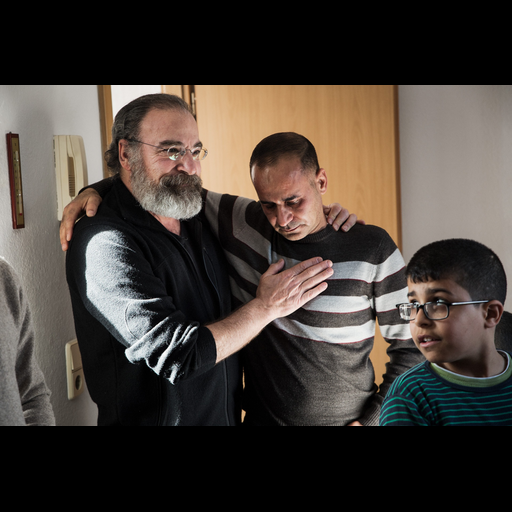

In [39]:
# 4.1 test - pad size to square img
test_img_path = random.choice(image_files)
raw_img = Image.open(test_img_path).convert("RGB")
resized_img = resize_with_padding(raw_img, target_size=(CONFIG["image_size"], CONFIG["image_size"]))

print("Original size:", raw_img.size)
print("Resized + padded size:", resized_img.size)
display(resized_img)


In [40]:
# 4.2 - detect faces in img
import numpy as np

def detect_faces_with_filter(pil_img, mtcnn, min_area_ratio=0.001, min_confidence=0.90, verbose=True):
    img_np = np.array(pil_img)
    width, height = pil_img.size
    img_area = width * height
    boxes, probs = mtcnn.detect(pil_img)

    if boxes is None or len(boxes) == 0:
        if verbose:
            print("⚠️ No faces detected.")
        return [], [], []

    kept, low_conf, too_small = [], [], []

    for i, (box, conf) in enumerate(zip(boxes, probs)):
        if conf is None or conf < min_confidence:
            if verbose:
                print(f"⚫ Face {i} skipped (low confidence: {conf:.2f})")
            low_conf.append((box, conf))
            continue

        x1, y1, x2, y2 = map(int, box)
        area = (x2 - x1) * (y2 - y1)
        if area / img_area < min_area_ratio:
            if verbose:
                print(f"⚪ Face {i} skipped (too small: {area/img_area:.2%})")
            too_small.append((box, conf))
            continue

        if verbose:
            print(f"🔴 Face {i} kept: conf={conf:.2f}, size={area/img_area:.2%}")
        kept.append((box, conf))

    if verbose:
        print(f"🧠 Total valid faces: {len(kept)}")
    return kept, low_conf, too_small


▶️ Testing on: 000004064.jpg
  Original size: (2000, 1200)
  Padded size:   (512, 512)
🔴 Face 0 kept: conf=1.00, size=2.58%
🧠 Total valid faces: 1


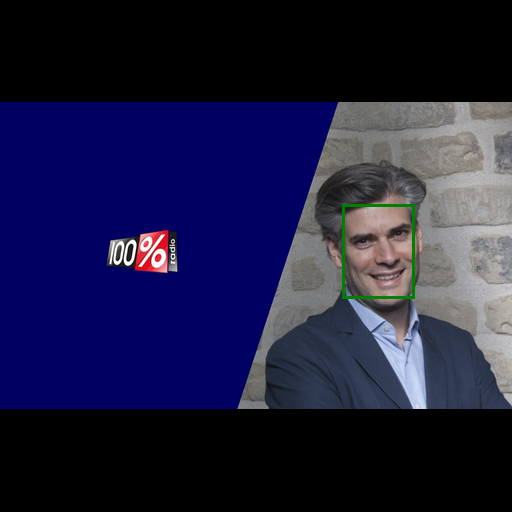

In [41]:
import random
import numpy as np
from PIL import Image, ImageOps, ImageDraw
from IPython.display import display

# — your helpers from 4.1 & 4.2 —
# resize_with_padding(...) as defined
# detect_faces_with_filter(...) as defined

def test_module_4_2(image_files, mtcnn_detector, config,
                    resize_with_padding, detect_faces_with_filter):
    """
    1) Loads one random image
    2) Pads it to square
    3) Runs face detection + filtering
    4) Draws bounding boxes
    5) Displays result
    """
    assert image_files, "No images provided!"
    path = random.choice(image_files)

    # Load & pad (preserve aspect ratio)
    raw = Image.open(path).convert("RGB")
    img = resize_with_padding(raw, target_size=(config["image_size"], config["image_size"]))

    print("▶️ Testing on:", path.split("/")[-1])
    print("  Original size:", raw.size)
    print("  Padded size:  ", img.size)

    # Detect + filter
    kept, low_conf, too_small = detect_faces_with_filter(
        pil_img=img,
        mtcnn=mtcnn_detector,
        min_area_ratio=config.get("min_face_ratio", 0.001),
        min_confidence=config.get("min_confidence", 0.90),
        verbose=True
    )

    # Draw boxes for debugging
    draw = ImageDraw.Draw(img)
    for box, _ in kept:
        draw.rectangle(box, outline="green", width=3)
    for box, _ in low_conf:
        draw.rectangle(box, outline="black", width=2)
    for box, _ in too_small:
        draw.rectangle(box, outline="white", width=2)

    display(img)

# Run it:
test_module_4_2(
    image_files=image_files,
    mtcnn_detector=mtcnn_detector,
    config=CONFIG,
    resize_with_padding=resize_with_padding,
    detect_faces_with_filter=detect_faces_with_filter
)


In [42]:
#4.3 module gen elliptical
from PIL import Image, ImageDraw

def generate_elliptical_mask(pil_img, face_boxes, face_probs=None,
                              min_area_ratio=None, min_confidence=None, expand_ratio: float = 1.0):
    """
    Generates a binary mask with white elliptical regions over detected faces.

    Args:
        pil_img (PIL.Image): Input image (RGB).
        face_boxes (List): List of (x1, y1, x2, y2) face bounding boxes.
        face_probs (List): List of confidence scores corresponding to face_boxes.
        min_area_ratio (float): Minimum face area relative to image (fallbacks to CONFIG).
        min_confidence (float): Minimum confidence score (fallbacks to CONFIG).

    Returns:
        Tuple[PIL.Image, List[Tuple[int, int, int, int]]]:
            - The elliptical binary mask.
            - The final list of accepted face boxes.
    """
    if min_area_ratio is None:
        min_area_ratio = CONFIG.get("min_face_ratio", 0.001)
    if min_confidence is None:
        min_confidence = CONFIG.get("min_confidence", 0.90)

    width, height = pil_img.size
    img_area = width * height
    mask = Image.new("L", (width, height), 0)
    draw = ImageDraw.Draw(mask)

    kept_boxes = []
    for i, box in enumerate(face_boxes):
        if face_probs is not None and i < len(face_probs):
            if face_probs[i] < min_confidence:
                continue
        x1, y1, x2, y2 = map(int, box)
        face_area = (x2 - x1) * (y2 - y1)
        if face_area < min_area_ratio * img_area:
            continue
        cx, cy = (x1 + x2) / 2, (y1 + y2) / 2
        w = (x2 - x1) * expand_ratio
        h = (y2 - y1) * expand_ratio
        # recompute expanded corners
        x1n = int(cx - w/2)
        y1n = int(cy - h/2)
        x2n = int(cx + w/2)
        y2n = int(cy + h/2)

        draw.ellipse([x1n, y1n, x2n, y2n], fill=255)
        kept_boxes.append((x1n, y1n, x2n, y2n))
    return mask, kept_boxes


🔴 Face 0 kept: conf=1.00, size=2.89%
🧠 Total valid faces: 1
✅ Displaying original image with face boxes:


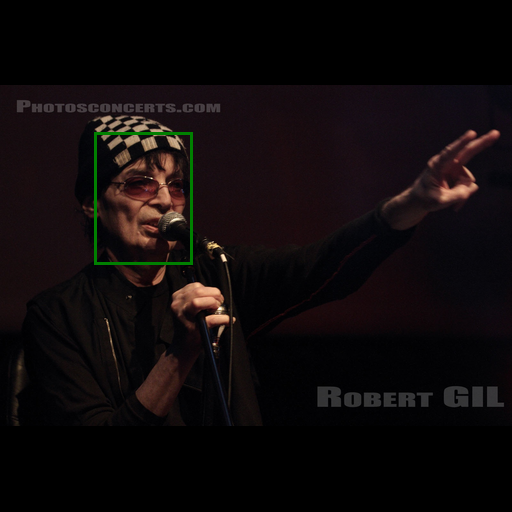

🎭 Corresponding elliptical face mask:


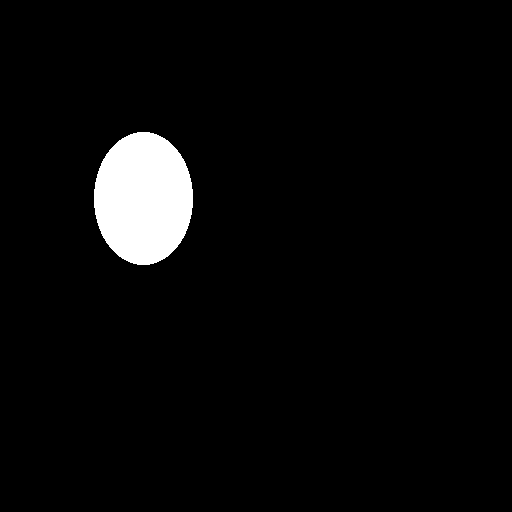

In [43]:
# 4.3 test elliptical amask
from PIL import ImageDraw
from IPython.display import display

def test_generate_elliptical_mask(image_files, mtcnn_detector, config, expand_ratio):
    """
    Test for Module 4.2 - generates and visualizes elliptical mask for a test image.
    """
    # Step 1: Load and resize a test image
    test_path = random.choice(image_files)
    raw_img = Image.open(test_path).convert("RGB")
    resized_img = resize_with_padding(raw_img, target_size=(config["image_size"], config["image_size"]))

    # Step 2: Detect faces
    kept, low_conf, too_small = detect_faces_with_filter(
        resized_img,
        mtcnn=mtcnn_detector,
        min_area_ratio=config.get("min_face_ratio", 0.001),
        min_confidence=config.get("min_confidence", 0.90),
        verbose=True
    )

    # Step 3: Create elliptical mask
    valid_boxes = [box for box, _ in kept]
    valid_scores = [score for _, score in kept]
    mask, final_boxes = generate_elliptical_mask(
        resized_img,
        face_boxes=valid_boxes,
        face_probs=valid_scores,
        min_area_ratio=config.get("min_face_ratio", 0.001),
        min_confidence=config.get("min_confidence", 0.90),
        expand_ratio   = 1.3
    )

    # Step 4: Visualize
    print("✅ Displaying original image with face boxes:")
    drawn = resized_img.copy()
    draw = ImageDraw.Draw(drawn)
    for box in final_boxes:
        draw.rectangle(box, outline="green", width=3)
    display(drawn)

    print("🎭 Corresponding elliptical face mask:")
    display(mask)


test_generate_elliptical_mask(image_files=image_files, mtcnn_detector=mtcnn_detector, config=CONFIG, expand_ratio = 1.3)


In [44]:
import mediapipe as mp
import numpy as np

def estimate_yaw_mediapipe(pil_img, face_boxes, config):
    """
    Estimates yaw angle (left/right orientation) for each face box using MediaPipe Face Mesh.

    Args:
        pil_img (PIL.Image): Input image.
        face_boxes (list): List of (x1, y1, x2, y2) tuples.

    Returns:
        List[Tuple[float or None, str]]: List of (yaw_angle, suffix) per face.
    """
    mp_face_mesh = mp.solutions.face_mesh
    with mp_face_mesh.FaceMesh(static_image_mode=True, max_num_faces=10) as face_mesh:
        img_np = np.array(pil_img)
        results = face_mesh.process(img_np)

        if not results.multi_face_landmarks:
            return [(None, "")] * len(face_boxes)

        # Convert normalized landmarks to pixel coordinates
        landmark_sets = []
        for face_landmarks in results.multi_face_landmarks:
            points = [(int(lm.x * pil_img.width), int(lm.y * pil_img.height)) for lm in face_landmarks.landmark]
            landmark_sets.append(points)

        def compute_yaw(landmarks):
            try:
                left_eye = np.array(landmarks[33])    # Left eye (viewer’s perspective)
                right_eye = np.array(landmarks[263])  # Right eye
                dx, dy = right_eye - left_eye
                yaw = np.degrees(np.arctan2(dy, dx))
                suffix = " side angle" if abs(yaw) > 30 else ""
                return yaw, suffix
            except:
                return None, ""

        # build 4-tuples: (yaw, pitch=0.0, yaw_suffix, pitch_suffix="")
        results = []
        for yaw, suffix in (compute_yaw(lms) for lms in landmark_sets[:len(face_boxes)]):
            # here we’re not estimating pitch, so set it to 0.0 and empty suffix
            results.append((yaw or 0.0, 0.0, suffix or "", ""))
        return results


In [45]:
import matplotlib.pyplot as plt
from PIL import ImageDraw

def test_estimate_yaw(image_files, mtcnn_detector, config):
    test_path = random.choice(image_files)
    raw_img = Image.open(test_path).convert("RGB")
    resized_img = resize_with_padding(raw_img, target_size=(config["image_size"], config["image_size"]))

    kept, _, _ = detect_faces_with_filter(
        resized_img, mtcnn_detector,
        min_area_ratio=config["min_face_ratio"],
        min_confidence=config["min_confidence"],
        verbose=True
    )

    kept_boxes = [box for box, _ in kept]
    yaw_data = estimate_yaw_mediapipe(resized_img, kept_boxes)

    # Draw image with yaw info
    drawn = resized_img.copy()
    draw = ImageDraw.Draw(drawn)
    for i, ((x1, y1, x2, y2), (yaw, suffix)) in enumerate(zip(kept_boxes, yaw_data)):
        draw.rectangle([x1, y1, x2, y2], outline="green", width=3)
        text = f"Yaw: {yaw:.1f}°{suffix}" if yaw is not None else "Yaw: Unknown"
        draw.text((x1, y1 - 10), text, fill="white")

    print(f"🧠 Yaw estimation complete for {len(kept_boxes)} face(s).")
    display(drawn)

# 🔍 Run the test
test_estimate_yaw(image_files=image_files, mtcnn_detector=mtcnn_detector, config=CONFIG)


🔴 Face 0 kept: conf=1.00, size=2.75%
🔴 Face 1 kept: conf=1.00, size=2.04%
🧠 Total valid faces: 2


TypeError: estimate_yaw_mediapipe() missing 1 required positional argument: 'config'

In [ ]:
def generate_dynamic_prompts(
    yaw_data,
    age_groups,
    base_prompt="realistic human face",
    extra_tags="highly detailed, intricate details, sharp focus, ultra-detailed skin texture, masterpiece, best quality",
    negative_tags="deformed, cartoon, illustration, painting, drawing, sketch, anime, disfigured, ugly, blurry, low quality, noisy, text, signature, watermark, multiple faces, extra limbs, fused fingers, bad anatomy, worst quality, normal quality"
):
    """
    Generate a list of positive and negative prompts for each detected face.

    Args:
        yaw_data (List[Tuple[float, str]]): List of (yaw_angle, yaw_suffix) per face.
        age_groups (List[str]): List of age group labels (e.g., "young adult").
        base_prompt (str): Base semantic prompt.
        extra_tags (str): Style-focused tags for enhancement.
        negative_tags (str): Tags to avoid during inpainting.

    Returns:
        List[Tuple[str, str]]: List of (positive_prompt, negative_prompt) per face.
    """
    prompts = []
    for i in range(len(yaw_data)):
        _, yaw_suffix = yaw_data[i] # e.g., " side angle" or ""
        age = age_groups[i]         # e.g., "young adult"

        # Compose full prompt <--- YAW AND AGE ARE INCLUDED HERE
        positive_prompt = f"{base_prompt}, {age}{yaw_suffix}, {extra_tags}"
        negative_prompt = negative_tags.strip()

        prompts.append((positive_prompt, negative_prompt))
    return prompts


In [ ]:
def test_prompt_generation_pipeline(image_files, mtcnn_detector, config):
    import random
    from PIL import ImageDraw

    test_path = random.choice(image_files)
    raw_img = Image.open(test_path).convert("RGB")
    resized_img = resize_with_padding(raw_img, target_size=(config["image_size"], config["image_size"]))

    kept, _, _ = detect_faces_with_filter(
        resized_img, mtcnn_detector,
        min_area_ratio=config["min_face_ratio"],
        min_confidence=config["min_confidence"],
        verbose=True
    )

    kept_boxes = [box for box, _ in kept]
    if not kept_boxes:
        print("❌ No valid faces to generate prompts.")
        return

    # Yaw & age estimation
    yaw_data = estimate_yaw_mediapipe(resized_img, kept_boxes)
    age_groups = []
    for (x1, y1, x2, y2) in kept_boxes:
        crop = resized_img.crop((x1, y1, x2, y2))
        age_groups.append(estimate_age(crop))

    prompts = generate_dynamic_prompts(yaw_data, age_groups)

    # Display
    drawn = resized_img.copy()
    draw = ImageDraw.Draw(drawn)
    for i, ((x1, y1, x2, y2), prompt) in enumerate(zip(kept_boxes, prompts)):
        draw.rectangle([x1, y1, x2, y2], outline="blue", width=2)
        draw.text((x1, y2 + 5), f"{prompt[:50]}...", fill="white")

    print(f"✅ Generated prompts for {len(prompts)} face(s).")
    for p in prompts:
        print(f"🔤 {p}")
    display(drawn)


In [ ]:
test_prompt_generation_pipeline(image_files=image_files, mtcnn_detector=mtcnn_detector, config=CONFIG)


In [ ]:
!pip install scikit-image lpips

In [ ]:
# --- Standard Library Imports ---
import logging
import os
import random
from itertools import product
from typing import List, Tuple, Union, Dict, Optional

# --- Third-Party Imports ---
import cv2  # Import OpenCV for BGR conversion and solvePnP
import numpy as np
import torch
from PIL import Image, ImageDraw, ImageOps  # ImageOps for potential BGR conversion

# Optional imports - check availability
try:
    import lpips
except ImportError:
    lpips = None
    logging.warning("lpips library not found. LPIPS calculations will be skipped.")
try:
    from transformers import CLIPProcessor, CLIPModel
except ImportError:
    CLIPProcessor = None
    CLIPModel = None
    logging.warning(
        "transformers library not found. CLIP calculations will be skipped."
    )
try:
    from facenet_pytorch import MTCNN
except ImportError:
    MTCNN = None
    logging.warning(
        "facenet_pytorch library not found. "
        "MTCNN detector cannot be initialized by default."
    )
try:
    import mediapipe as mp

    mp_face_mesh = mp.solutions.face_mesh
    mp_drawing = mp.solutions.drawing_utils
    mp_drawing_styles = mp.solutions.drawing_styles
except ImportError:
    mp = None
    mp_face_mesh = None
    logging.error(
        "mediapipe library not found. "
        "Pose estimation and landmark features will be disabled."
    )
try:
    from skimage.metrics import structural_similarity as ssim
except ImportError:
    ssim = None
    logging.warning(
        "scikit-image not found. SSIM calculations will be skipped."
    )


# --- Configure Logging ---
logging.basicConfig(
    level=logging.INFO, format="%(asctime)s - %(levelname)s - %(message)s"
)

# --- Initialize MediaPipe Face Mesh ---
face_mesh = None
if mp_face_mesh:
    try:
        face_mesh = mp_face_mesh.FaceMesh(
            static_image_mode=True,
            max_num_faces=1,  # Process one face at a time for pose robustness
            refine_landmarks=True,  # Refine landmarks for better pose accuracy
            min_detection_confidence=0.5,
        )
        logging.info(
            "✅ MediaPipe FaceMesh initialized successfully "
            "(with landmark refinement)."
        )
    except Exception as e:
        logging.error(f"❌ Failed to initialize MediaPipe FaceMesh: {e}")
        face_mesh = None
else:
    logging.error(
        "❌ MediaPipe FaceMesh cannot be initialized because "
        "mediapipe library is not available."
    )

# --- Assume other necessary helpers/objects are defined elsewhere: ---
# - estimate_age: Function to estimate age from a face crop.
# - resize_with_padding: Function to resize an image with padding.
# - detect_faces_with_filter: Function to detect/filter faces (e.g., MTCNN).
# - mtcnn_detector: An instance of the face detector (e.g., MTCNN).
# - pipe_lora: The Stable Diffusion (or similar) pipeline object.
# Also assume a CONFIG dictionary exists and is populated, e.g.:
# CONFIG = {
#     "device": "cuda" if torch.cuda.is_available() else "cpu",
#     "image_size": 512, "min_face_ratio": 0.05, "min_confidence": 0.9,
#     "guidance_scale": 7.5, "num_inference_steps": 30, "num_candidates": 4,
#     "rerank_shiny_candidates": 4, "shine_threshold": 200,
#     "base_seed": random.randint(0, 100000),
#     "clip_weight": 0.4, "lpips_weight": 0.2, "ssim_weight": 0.2, "land_weight": 0.2,
#     "landmark_yaw_threshold": 30.0, "landmark_pitch_threshold": 15.0,
#     "landmark_min_pts": 10, "landmark_vis_threshold": 0.5,
#     "pose_yaw_threshold": 15.0, "pose_pitch_threshold": 10.0,
# }
# --- End Assumptions ---

# --- Default MTCNN Initialization (Example) ---
mtcnn_detector = None
if MTCNN and "CONFIG" in locals() and "device" in CONFIG:
    try:
        logging.info(
            f"🔄 Initializing default MTCNN detector on device: {CONFIG['device']}..."
        )
        mtcnn_detector = MTCNN(
            keep_all=True, device=CONFIG["device"], select_largest=False
        )
        logging.info("✅ Default MTCNN detector initialized.")
    except Exception as e:
        logging.warning(f"⚠️ Could not initialize default MTCNN detector: {e}")
else:
    if not MTCNN:
        logging.warning(
            "⚠️ MTCNN detector skipped: facenet_pytorch not available."
        )
    else:
        logging.warning(
            "⚠️ MTCNN detector skipped: CONFIG or device not defined."
        )


# --- LPIPS Model Initialization ---
lpips_model = None
if lpips:
    try:
        if "CONFIG" in locals() and isinstance(CONFIG, dict) and "device" in CONFIG:
            logging.info(
                f"🔄 Loading LPIPS model (vgg) to device: {CONFIG['device']}..."
            )
            lpips_model = lpips.LPIPS(net="vgg").to(CONFIG["device"])
            lpips_model.eval()
            logging.info("✅ LPIPS model loaded successfully.")
        else:
            logging.warning(
                "⚠️ LPIPS model loading skipped: CONFIG or device key not defined."
            )
    except Exception as e:
        logging.warning(f"⚠️ Could not load LPIPS model: {e}")
        lpips_model = None
else:
    logging.warning("⚠️ LPIPS model skipped: lpips library not available.")


# --- CLIP Model and Processor Initialization ---
clip_model_name = "openai/clip-vit-large-patch14"
clip_model = None
clip_processor = None
if CLIPModel and CLIPProcessor:
    try:
        if "CONFIG" in locals() and isinstance(CONFIG, dict) and "device" in CONFIG:
            logging.info(f"🔄 Loading CLIP model: {clip_model_name}...")
            clip_model = CLIPModel.from_pretrained(clip_model_name).to(
                CONFIG["device"]
            )
            clip_processor = CLIPProcessor.from_pretrained(clip_model_name)
            clip_model.eval()
            logging.info("✅ CLIP model and processor loaded successfully.")
        else:
            logging.warning(
                "⚠️ CLIP model/processor loading skipped: "
                "CONFIG or device key not defined."
            )
    except Exception as e:
        logging.warning(f"⚠️ Could not load CLIP model/processor: {e}")
        clip_model = None
        clip_processor = None
else:
    logging.warning(
        "⚠️ CLIP model/processor skipped: transformers library not available."
    )
# --- END Initialization Blocks ---


# --- FUNCTIONAL CLIP Score Calculation ---
@torch.no_grad()
def calculate_clip_score(
    image_pil: Optional[Image.Image],
    prompt_text: Optional[str],
    model: Optional[CLIPModel],
    processor: Optional[CLIPProcessor],
    device: str,
) -> Optional[float]:
    """Calculates a CLIP score between a single PIL image and a text prompt."""
    if not all([image_pil, prompt_text, model, processor]):
        logging.debug("CLIP score skipped: Missing inputs.")
        return None
    prompt = str(prompt_text)
    try:
        encoding = processor(
            text=[prompt],
            images=[image_pil],
            return_tensors="pt",
            padding=True,
            truncation=True,
        )
        for k, v in encoding.items():
            encoding[k] = v.to(device)
        img_feats = model.get_image_features(
            pixel_values=encoding["pixel_values"]
        )
        txt_feats = model.get_text_features(
            input_ids=encoding["input_ids"],
            attention_mask=encoding["attention_mask"],
        )
        img_feats = img_feats / img_feats.norm(dim=-1, keepdim=True)
        txt_feats = txt_feats / txt_feats.norm(dim=-1, keepdim=True)
        similarity = (img_feats * txt_feats).sum(dim=-1)
        score = float(
            torch.clamp(100 * similarity, min=0.0, max=100.0).item()
        )
        return score
    except Exception as e:
        logging.error(f"CLIP score calculation error (prompt={prompt!r}): {e}")
        return None


# --- Helper for LPIPS ---
def prepare_for_lpips(
    img_pil: Optional[Image.Image], device: str
) -> Optional[torch.Tensor]:
    """Converts PIL image to PyTorch tensor normalized for LPIPS."""
    if img_pil is None:
        return None
    transform = transforms.Compose(
        [
            transforms.ToTensor(),
            transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
        ]
    )
    try:
        return transform(img_pil).unsqueeze(0).to(device)
    except Exception as e:
        logging.error(f"Error preparing image for LPIPS: {e}")
        return None


# --- Helper to Format Metrics ---
def fmt_metric(val: Optional[Union[float, int]]) -> str:
    """Formats metric value to string 'N/A' or '0.XXXf'."""
    return f"{val:.3f}" if isinstance(val, (int, float)) else "N/A"


# --- Pose Estimation Function ---
def estimate_pose_mediapipe(
    image_pil: Image.Image,
    boxes: List[Tuple[float, float, float, float]],
    config: dict,
) -> List[Tuple[float, float, str, str]]:
    """Estimates head pose (yaw, pitch) and generates descriptive suffixes."""
    if face_mesh is None:
        logging.warning(
            "MediaPipe FaceMesh unavailable. "
            "Returning default pose (0, 0, '', '') for all faces."
        )
        return [(0.0, 0.0, "", "")] * len(boxes)

    img_np_rgb = np.array(image_pil)
    img_h, img_w = img_np_rgb.shape[:2]
    pose_results = []
    yaw_thresh = config.get("pose_yaw_threshold", 15.0)
    pitch_thresh = config.get("pose_pitch_threshold", 10.0)

    # Canonical face model points (indices based on MediaPipe landmarks)
    face_3d_model_points = np.array(
        [
            [0.0, 0.0, 0.0],  # Nose tip (1)
            [0.0, -330.0, -65.0],  # Chin (152)
            [-225.0, 170.0, -135.0],  # Left eye left corner (263)
            [225.0, 170.0, -135.0],  # Right eye right corner (33)
            [-150.0, -150.0, -125.0],  # Left Mouth corner (61)
            [150.0, -150.0, -125.0],  # Right mouth corner (291)
        ],
        dtype=np.float64,
    )

    # Camera internals (approximate)
    focal_length = img_w
    center = (img_w / 2, img_h / 2)
    camera_matrix = np.array(
        [[focal_length, 0, center[0]], [0, focal_length, center[1]], [0, 0, 1]],
        dtype=np.float64,
    )
    dist_coeffs = np.zeros((4, 1))  # Assume no lens distortion

    for i, box in enumerate(boxes):
        yaw_angle, pitch_angle = 0.0, 0.0
        yaw_suffix, pitch_suffix = "", ""
        try:
            # Prepare face crop for MediaPipe
            x1, y1, x2, y2 = map(int, box)
            x1, y1 = max(0, x1), max(0, y1)
            x2, y2 = min(img_w, x2), min(img_h, y2)
            if x1 >= x2 or y1 >= y2:
                logging.warning(f"Skipping pose for invalid box {i}: {box}")
                pose_results.append((0.0, 0.0, "", ""))
                continue

            face_crop_np = img_np_rgb[y1:y2, x1:x2]
            if face_crop_np.size == 0: # Check if crop is empty
                logging.warning(f"Skipping pose for empty crop from box {i}: {box}")
                pose_results.append((0.0, 0.0, "", ""))
                continue

            face_crop_bgr = cv2.cvtColor(face_crop_np, cv2.COLOR_RGB2BGR)
            mp_results = face_mesh.process(face_crop_bgr)

            if mp_results.multi_face_landmarks:
                landmarks = mp_results.multi_face_landmarks[0].landmark
                required_indices = [1, 152, 263, 33, 61, 291]

                # Check if all required landmarks are within the detected range
                if all(idx < len(landmarks) for idx in required_indices):
                    # Extract 2D points corresponding to the 3D model
                    face_2d_image_points = np.array(
                        [
                            (
                                landmarks[idx].x * face_crop_np.shape[1],
                                landmarks[idx].y * face_crop_np.shape[0],
                            )
                            for idx in required_indices
                        ],
                        dtype=np.float64,
                    )

                    # Solve PnP
                    success, rotation_vector, _ = cv2.solvePnP(
                        face_3d_model_points,
                        face_2d_image_points,
                        camera_matrix,
                        dist_coeffs,
                        flags=cv2.SOLVEPNP_ITERATIVE, # Use iterative method
                    )

                    if success:
                        rotation_matrix, _ = cv2.Rodrigues(rotation_vector)
                        angles, _, _, _, _, _ = cv2.RQDecomp3x3(rotation_matrix)
                        pitch_angle, yaw_angle = angles[0], angles[1]

                        # Determine suffixes
                        if yaw_angle > yaw_thresh:
                            yaw_suffix = " facing right"
                        elif yaw_angle < -yaw_thresh:
                            yaw_suffix = " facing left"
                        if pitch_angle > pitch_thresh:
                            pitch_suffix = " looking down"
                        elif pitch_angle < -pitch_thresh:
                            pitch_suffix = " looking up"
                else:
                    logging.debug(
                        f"Required landmarks missing for pose estimation in face {i}."
                    )
            else:
                logging.debug(
                    f"No landmarks found by MediaPipe for face {i} in crop."
                )
        except Exception as e_pose:
            logging.warning(f"Error estimating pose for face {i}: {e_pose}")

        pose_results.append((yaw_angle, pitch_angle, yaw_suffix, pitch_suffix))
    return pose_results


# --- Landmark Extraction Helper ---
def extract_visible_landmarks(
    img_np_rgb: np.ndarray, vis_thresh: float = 0.5
) -> List[Tuple[float, float]]:
    """Extracts visible facial landmarks using MediaPipe Face Mesh."""
    if face_mesh is None:
        return []
    try:
        if not isinstance(img_np_rgb, np.ndarray):
            img_np_rgb = np.array(img_np_rgb)
        # Ensure image has 3 dimensions (H, W, C)
        if img_np_rgb.ndim != 3 or img_np_rgb.shape[2] not in [3, 4]:
             logging.warning(f"Unexpected image shape for landmark extraction: {img_np_rgb.shape}")
             return []
        # Convert RGB/RGBA to BGR
        if img_np_rgb.shape[2] == 3:
            image_bgr = cv2.cvtColor(img_np_rgb, cv2.COLOR_RGB2BGR)
        else: # RGBA
            image_bgr = cv2.cvtColor(img_np_rgb, cv2.COLOR_RGBA2BGR)

        results = face_mesh.process(image_bgr)
        if not results.multi_face_landmarks:
            return []
        landmarks = results.multi_face_landmarks[0].landmark
        # Use visibility if available, otherwise default to visible
        return [
            (lm.x, lm.y)
            for lm in landmarks
            if getattr(lm, "visibility", 1.0) >= vis_thresh
        ]
    except Exception as e:
        logging.error(f"Error during landmark extraction: {e}")
        return []


# --- Landmark Consistency Metric ---
def compute_landmark_sim(
    orig_np_rgb: np.ndarray, gen_np_rgb: np.ndarray, config: dict
) -> Optional[float]:
    """Computes landmark similarity score (0-1, higher is better)."""
    min_pts = config.get("landmark_min_pts", 10)
    vis_thresh = config.get("landmark_vis_threshold", 0.5)
    o_pts = extract_visible_landmarks(orig_np_rgb, vis_thresh)
    g_pts = extract_visible_landmarks(gen_np_rgb, vis_thresh)

    if len(o_pts) < min_pts or len(o_pts) != len(g_pts):
        return None
    try:
        dists = [
            np.hypot(ox - gx, oy - gy)
            for (ox, oy), (gx, gy) in zip(o_pts, g_pts)
        ]
        mean_dist = sum(dists) / len(dists)
        o_x = [x for x, _ in o_pts]
        # Add epsilon to prevent division by zero if face is extremely narrow
        face_width = max(o_x) - min(o_x) + 1e-6
        return max(0.0, 1.0 - (mean_dist / face_width))
    except Exception as e:
        logging.error(f"Error calculating landmark similarity: {e}")
        return None


# --- Min-Max Normalization Helper ---
def minmax(arr: List[Optional[float]]) -> List[Optional[float]]:
    """Applies Min-Max normalization to a list [0, 1], preserving None."""
    valid_arr = [x for x in arr if isinstance(x, (int, float))]
    if not valid_arr:
        return arr  # Return original if no valid data
    if len(set(valid_arr)) == 1:
        # All valid values are the same, return 0.5 for valid, None for None
        return [0.5 if isinstance(x, (int, float)) else None for x in arr]

    mn, mx = min(valid_arr), max(valid_arr)
    denominator = mx - mn + 1e-6  # Add epsilon for stability
    normalized = [
        (x - mn) / denominator if isinstance(x, (int, float)) else None
        for x in arr
    ]
    # Clamp final result strictly between 0 and 1
    return [
        max(0.0, min(1.0, x)) if isinstance(x, (int, float)) else None
        for x in normalized
    ]



# --- End Helper functions

In [ ]:
import torch
import numpy as np
import logging
import random
import traceback
from itertools import product
from PIL import Image, ImageDraw, ImageOps, ImageFilter # Added ImageFilter
import matplotlib.pyplot as plt
from typing import List, Tuple, Union, Dict, Optional

# Assume necessary helper functions are defined elsewhere:
# - batchify(iterable, batch_size) -> yields tuples
# - calculate_clip_score(img, prompt, model, proc, device) -> Optional[float]
# - prepare_for_lpips(img_pil, device) -> Optional[torch.Tensor]
# - ssim (from skimage.metrics) -> Optional[float]
# - compute_landmark_sim(orig_np, gen_np, config) -> Optional[float]
# - minmax(arr) -> List[Optional[float]]
# - fmt_metric(val) -> str
# - get_eye_boxes(np_face_rgb, W, H, padding) -> List[Optional[Tuple[int,int,int,int]]]
# - get_nose_box(np_face_rgb, W, H, padding) -> Optional[Tuple[int,int,int,int]]
# Also assume necessary models/objects are passed correctly:
# - pipe_lora, mtcnn_detector, lpips_model, clip_model, clip_processor

# --- Main Reranking Function (FIXED with batch list conversion + imports) ---
@torch.no_grad()
def run_module_4_5_reranked(
    image_pil: Image.Image,
    face_masks: List[Image.Image],
    boxes: List[Tuple[float, float, float, float]],
    age_labels: List[str],
    yaw_data: List[Tuple[Optional[float], str]], # Expected format
    pipe_lora, # Diffusion pipeline instance
    mtcnn_detector, # Face detector instance
    lpips_model, # LPIPS model instance (can be None)
    clip_model, # CLIP model instance (can be None)
    clip_processor, # CLIP processor instance (can be None)
    config: dict,
    base_prompt: str,
    base_extra_tags: str,
    base_neg_prompt: str,
    plot: bool = True,
) -> Dict[int, Dict[str, Optional[dict]]]:
    """
    Reranks inpainting candidates using multiple metrics, generates candidates in batches,
    and applies sequential micro-inpainting (with enhancements) to eyes and nose
    of the best candidate. Fixed batch type error.

    Args:
        image_pil: Input PIL image.
        face_masks: List of PIL binary masks for each face.
        boxes: List of bounding boxes (x1, y1, x2, y2) for each face.
        age_labels: List of estimated age group strings.
        yaw_data: List of (yaw_angle, yaw_suffix) tuples. Yaw angle can be None.
        pipe_lora: Initialized diffusion pipeline supporting LoRA.
        mtcnn_detector: Initialized face detector (e.g., MTCNN instance).
        lpips_model: Initialized LPIPS model (or None).
        clip_model: Initialized CLIP model (or None).
        clip_processor: Initialized CLIP processor (or None).
        config: Dictionary containing configuration parameters.
        base_prompt: Base text prompt for generation.
        base_extra_tags: Additional positive tags.
        base_neg_prompt: Negative tags to avoid.
        plot: Whether to display results using matplotlib.

    Returns:
        Dictionary mapping face index (int) to another dictionary.
        The inner dictionary maps condition key (str) to the best candidate's data (dict)
        or None if no valid candidate was found for that condition.
        Example: {0: {"asian_male": {<candidate_data>}, "caucasian_female": None, ...}}
    """
    # --- Configuration ---
    device = config["device"]
    guidance = config["guidance_scale"]
    steps    = config["num_inference_steps"]
    N        = config["num_candidates"]
    K        = config.get("rerank_shiny_candidates", 4) # Placeholder
    shine_th = config.get("shine_threshold", 200)     # Placeholder
    landmark_yaw_thresh = config.get("landmark_yaw_threshold", 30.0)
    gen_batch_size = config.get("generation_batch_size", 2)
    # Micro-inpaint specific config
    apply_eye_inpaint = config.get("apply_eye_inpaint", True)
    apply_nose_inpaint = config.get("apply_nose_inpaint", True)
    nose_padding = config.get("nose_padding", 0.15)

    # Base metric weights
    base_weights = {
        "clip": config.get("clip_weight", 0.4), "lpips": config.get("lpips_weight", 0.2),
        "ssim": config.get("ssim_weight", 0.2), "land": config.get("land_weight", 0.2)
    }

    # --- Input Image Preparation ---
    S = config["image_size"]
    if image_pil.size != (S,S):
        logging.info(f"Resizing input image from {image_pil.size} to ({S},{S})")
        # Ensure LANCZOS is used if available, otherwise default
        resampling_method = Image.Resampling.LANCZOS if hasattr(Image.Resampling, 'LANCZOS') else Image.Resampling.LANCZOS
        image_pil = image_pil.resize((S,S), resampling_method)
    img_input = image_pil.convert("RGB")

    # --- Condition Definitions ---
    races    = ["asian", "caucasian", "african", "middle eastern"]
    genders  = ["male", "female"]
    conds    = [f"{r}_{g}" for r,g in product(races,genders)]
    cond_txt = [f"{r} {g}" for r,g in product(races,genders)]

    results = {} # Final results dictionary

    # --- Iterate through each detected face ---
    for i, mask in enumerate(face_masks):
        # Check if corresponding data exists for the current mask index
        if i >= len(boxes) or i >= len(age_labels) or i >= len(yaw_data):
            logging.warning(f"Skipping mask {i}: Missing corresponding box, age, or yaw data.")
            continue

        logging.info(f"\n--- Processing Face {i+1} ---")

        # Get Age and Yaw safely
        age = str(age_labels[i]) if age_labels[i] is not None else "adult"
        current_yaw_angle: Optional[float] = None # Initialize as None
        yaw_suffix: str = ""
        try:
            yaw_angle_val, yaw_suffix_val = yaw_data[i]
            if isinstance(yaw_angle_val, (int, float)):
                 # Check for NaN explicitly as it's a float but invalid for calculations
                 if not np.isnan(yaw_angle_val):
                      current_yaw_angle = float(yaw_angle_val)
                 else:
                      logging.warning(f"Yaw angle for face {i+1} is NaN. Treating as unknown.")
            elif yaw_angle_val is not None:
                 logging.warning(f"Invalid yaw angle type: {type(yaw_angle_val)}. Treating as unknown.")

            yaw_suffix = str(yaw_suffix_val) if yaw_suffix_val is not None else ""
            logging.info(f"Face Info: Age='{age}', Yaw Angle={fmt_metric(current_yaw_angle)}, Yaw Suffix='{yaw_suffix}'")
        except (TypeError, IndexError, ValueError) as e_yaw:
            logging.warning(f"Could not extract yaw data for face {i+1}: {e_yaw}. Using defaults.")
            current_yaw_angle = None # Ensure it's None on error
            yaw_suffix = ""

        # Prepare Mask and Original Crop
        try:
            # Ensure mask is the correct size and mode
            mask_resample = Image.Resampling.NEAREST if hasattr(Image.Resampling, 'NEAREST') else Image.NEAREST
            m = mask.resize(img_input.size, mask_resample).convert("L")
        except Exception as e_mask:
            logging.error(f"Error processing mask for face {i+1}: {e_mask}. Skipping face.")
            results[i] = {cond_key: None for cond_key in conds} # Indicate failure for all conditions
            continue

        # Validate box coordinates and create crop
        x1,y1,x2,y2 = map(int, boxes[i])
        x1,y1 = max(0,x1), max(0,y1)
        x2,y2 = min(S,x2), min(S,y2)
        orig_crop_pil, orig_crop_np_rgb = None, None
        if x1 < x2 and y1 < y2: # Check if coordinates form a valid rectangle
            try:
                orig_crop_pil = img_input.crop((x1,y1,x2,y2))
                orig_crop_np_rgb = np.array(orig_crop_pil)
                logging.debug(f"Original face {i+1} cropped at ({x1},{y1},{x2},{y2}).")
            except Exception as e_crop:
                logging.warning(f"Error cropping original face {i+1}: {e_crop}. Metrics needing crop will be skipped.")
        else:
             logging.warning(f"Invalid bounding box face {i+1}: ({x1},{y1},{x2},{y2}). Metrics needing crop will be skipped.")

        # --- Process candidates per condition ---
        best_per_cond = {}
        for ci, cond_key in enumerate(conds):
            logging.info(f"--- Processing Condition: {cond_key} for Face {i+1} ---")
            txt = cond_txt[ci]

            # 1a) Prepare inputs for batch generation
            logging.debug(f"Preparing {N} candidate inputs for {cond_key}...")
            seeds_cond = [config.get("base_seed", random.randint(0, 10000)) + i*1000 + ci*100 + j for j in range(N)]
            # Construct prompt carefully, handling potential None/empty values
            prompt_cond = f"{str(base_prompt)} of a {age} {str(txt)}{yaw_suffix}, {str(base_extra_tags)}".strip()
            prompts_cond = [prompt_cond] * N
            neg_prompts_cond = [str(base_neg_prompt).strip()] * N

            # 1b) Generate N candidates in batches
            logging.info(f"Generating {N} candidates in batches of {gen_batch_size} for {cond_key}...")
            all_gen_images_cond = []
            pipeline_errors = 0

            # Ensure batchify is available
            if 'batchify' not in globals():
                 logging.error("CRITICAL: batchify function is not defined. Cannot generate batches.")
                 best_per_cond[cond_key] = None
                 continue # Skip this condition if batchify is missing

            for seed_batch, p_batch_tuple, n_batch_tuple in zip(
                batchify(seeds_cond, gen_batch_size),
                batchify(prompts_cond, gen_batch_size),
                batchify(neg_prompts_cond, gen_batch_size)
            ):
                try:
                    gens = [torch.Generator(device=device).manual_seed(s) for s in seed_batch]

                    # --- FIX: Convert tuples to lists ---
                    p_batch_list = list(p_batch_tuple)
                    n_batch_list = list(n_batch_tuple)
                    # -------------------------------------

                    # Check if lists are empty (shouldn't happen with valid batch_size>0)
                    if not p_batch_list:
                         logging.warning("Empty prompt batch encountered, skipping.")
                         continue

                    output = pipe_lora(
                        prompt=p_batch_list,          # Pass the list
                        negative_prompt=n_batch_list, # Pass the list
                        image=img_input,              # Pass the single input image
                        mask_image=m,                 # Pass the single mask for this face
                        guidance_scale=guidance,
                        num_inference_steps=steps,
                        generator=gens                # Pass the list of generators
                    )
                    # Ensure output.images is a list (even if batch size was 1)
                    output_images = output.images if isinstance(output.images, list) else [output.images]
                    all_gen_images_cond.extend(output_images)

                except Exception as e_pipe:
                    logging.error(f"Pipeline error during generation for batch seeds {seed_batch}: {e_pipe}")
                    logging.error(f"Prompt type: {type(p_batch_list)}, Neg prompt type: {type(n_batch_list)}") # Log types on error
                    # Add None placeholders for failed images in the batch
                    all_gen_images_cond.extend([None] * len(seed_batch))
                    pipeline_errors += len(seed_batch)
                    traceback.print_exc() # Print full traceback for pipeline errors

            # Check if generation failed completely for this condition
            if len(all_gen_images_cond) != N or pipeline_errors == N:
                 logging.error(f"Generation failed for condition '{cond_key}'. Skipping this condition.")
                 best_per_cond[cond_key] = None
                 continue # Move to the next condition

            # 1c) Calculate RAW metrics
            logging.info(f"Calculating raw metrics for {len(all_gen_images_cond)} candidates ({cond_key})...")
            cond_cands = []
            for j, img_out in enumerate(all_gen_images_cond):
                # Prepare metrics dict, ensuring seed/prompt correspond correctly
                seed, prompt = seeds_cond[j], prompts_cond[j]
                metrics = {
                    "cond": cond_key, "prompt": prompt, "seed": seed, "img": img_out,
                    "clip_score": None, "lpips_vs_orig": None, "ssim_vs_orig": None,
                    "landmark_sim": None, "is_shiny_rerun": False, "combined_score": -1.0, # Default score
                     "face_confidence": 0.0 # Default face confidence
                }

                # Skip metrics calculation if generation failed for this specific image
                if img_out is None:
                    logging.warning(f"Skipping metrics for candidate seed {seed}: Generation failed.")
                    cond_cands.append(metrics)
                    continue

                try:
                    # CLIP Score
                    metrics["clip_score"] = calculate_clip_score(img_out, prompt, clip_model, clip_processor, device)

                    # --- Metrics requiring face crop ---
                    gen_crop_pil = None
                    if x1 < x2 and y1 < y2: # Check box validity again
                        try:
                            gen_crop_pil = img_out.crop((x1, y1, x2, y2))
                        except Exception as e_crop_gen:
                            logging.warning(f"Error cropping generated image seed {seed}: {e_crop_gen}")

                    if gen_crop_pil: # Proceed only if generated crop is valid
                         # LPIPS Score
                         if lpips_model and orig_crop_pil:
                            t1, t2 = prepare_for_lpips(orig_crop_pil, device), prepare_for_lpips(gen_crop_pil, device)
                            if t1 is not None and t2 is not None:
                                try:
                                    metrics["lpips_vs_orig"] = float(lpips_model(t1, t2).item())
                                except Exception as e_lpips:
                                    logging.warning(f"LPIPS calculation failed seed {seed}: {e_lpips}")

                         # SSIM Score
                         if ssim and orig_crop_pil: # Check if ssim function is available
                            try:
                                # Resize original crop to match generated crop size for fair comparison
                                orig_r = orig_crop_pil.resize(gen_crop_pil.size, resampling_method) if orig_crop_pil.size != gen_crop_pil.size else orig_crop_pil
                                og, gg = np.array(orig_r.convert("L")), np.array(gen_crop_pil.convert("L"))

                                if og.size > 0 and gg.size > 0 and og.shape == gg.shape:
                                    # Ensure data range calculation uses valid array
                                    dr = og.max() - og.min() if og.max() > og.min() else 1.0 # Avoid zero range
                                    # Determine a safe window size
                                    min_dim = min(og.shape)
                                    # Window size must be odd, <= min_dim, and usually >= 3
                                    ws = min(7, min_dim)
                                    ws = max(3, ws // 2 * 2 + 1) # Ensure odd and at least 3

                                    if ws <= min_dim:
                                        metrics["ssim_vs_orig"] = float(ssim(og, gg, data_range=dr, win_size=ws))
                                    else:
                                        logging.warning(f"SSIM skipped seed {seed}: Min dim {min_dim} too small for win_size {ws}")
                                else:
                                    logging.warning(f"SSIM skipped seed {seed}: Mismatched shapes or empty arrays ({og.shape}, {gg.shape})")
                            except Exception as e_ssim:
                                logging.warning(f"SSIM calculation failed seed {seed}: {e_ssim}")

                         # Landmark Similarity (Pose-Aware)
                         # Check if yaw is valid (not None) and within threshold
                         if current_yaw_angle is not None and abs(current_yaw_angle) <= landmark_yaw_thresh:
                            if orig_crop_np_rgb is not None: # Ensure original crop numpy exists
                                try:
                                    gen_crop_np_rgb = np.array(gen_crop_pil)
                                    metrics["landmark_sim"] = compute_landmark_sim(orig_crop_np_rgb, gen_crop_np_rgb, config)
                                except Exception as e_land:
                                    logging.warning(f"Landmark similarity calculation failed seed {seed}: {e_land}")
                            else:
                                logging.debug(f"Skipping landmark sim seed {seed}: Original crop invalid.")
                         else:
                            logging.debug(f"Skipping landmark sim seed {seed}: Yaw={fmt_metric(current_yaw_angle)} outside threshold={landmark_yaw_thresh} or unknown.")

                except Exception as e_m:
                    logging.error(f"Unexpected error during metrics calculation for seed {seed}: {e_m}")
                    traceback.print_exc() # Log full traceback for unexpected errors

                cond_cands.append(metrics) # Append metrics dict even if some calcs failed

            # 2) Normalize Scores across candidates for this condition
            logging.debug(f"Normalizing scores for {len(cond_cands)} candidates ({cond_key})...")
            # Extract scores safely using .get()
            clip_scores_raw = [c.get("clip_score") for c in cond_cands]
            lpips_scores_raw = [c.get("lpips_vs_orig") for c in cond_cands]
            ssim_scores_raw = [c.get("ssim_vs_orig") for c in cond_cands]
            land_scores_raw = [c.get("landmark_sim") for c in cond_cands]

            # Normalize (minmax returns list of same size with None preserved)
            clip_n = minmax(clip_scores_raw)
            # Invert LPIPS after normalization (lower LPIPS is better)
            lpips_n = [(1.0 - v) if isinstance(v, float) else None for v in minmax(lpips_scores_raw)]
            ssim_n = minmax(ssim_scores_raw)
            land_n = minmax(land_scores_raw)

            # 3) Calculate Combined Score
            logging.debug(f"Calculating combined scores for {cond_key}...")
            for k, cand in enumerate(cond_cands):
                # Assign normalized scores back to candidate dict
                cand["clip_norm"] = clip_n[k]
                cand["lpips_norm"] = lpips_n[k]
                cand["ssim_norm"] = ssim_n[k]
                cand["land_norm"] = land_n[k]

                # Determine which metrics are actually available for this candidate
                present_metrics = {
                    "clip": cand["clip_norm"], "lpips": cand["lpips_norm"],
                    "ssim": cand["ssim_norm"], "land": cand["land_norm"]
                }
                valid_scores = {m: s for m, s in present_metrics.items() if isinstance(s, float)}

                # Calculate combined score only if at least one valid normalized score exists
                if valid_scores:
                     # Adjust weights based on available metrics
                     current_weights = {m: base_weights[m] for m in valid_scores.keys()}
                     total_w = sum(current_weights.values()) + 1e-6 # Avoid division by zero
                     # Calculate weighted sum
                     score = sum((current_weights[m] / total_w) * valid_scores[m] for m in valid_scores)
                     cand["combined_score"] = score
                else:
                     # If no valid metrics, keep default score -1.0
                     cand["combined_score"] = -1.0
                     logging.debug(f"Candidate seed {cand['seed']} has no valid metrics for scoring.")

            # 4) Select Best Candidate for this condition
            # Filter for candidates that have a valid image and a non-negative combined score
            valid_cands = [c for c in cond_cands if c.get("img") is not None and c.get("combined_score", -1.0) >= 0]
            if not valid_cands:
                 logging.warning(f"Condition '{cond_key}': No valid candidates found after scoring.")
                 best_initial = None
            else:
                 # Sort by combined score (descending)
                 valid_cands.sort(key=lambda c: c.get("combined_score", -1.0), reverse=True)
                 best_initial = valid_cands[0].copy() # Take a copy of the best one
                 logging.debug(f"Best initial candidate for {cond_key} seed {best_initial.get('seed')} score {best_initial.get('combined_score'):.4f}")
            best_final = best_initial # Initialize best_final

            # 5) Shiny Check and Rerank (Placeholder - needs implementation)
            # This section is complex and depends on your specific "shiny" definition and rerank strategy.
            # For now, it just passes the best_initial candidate.
            if best_initial:
                is_shiny = False # <<<< Placeholder: Implement your shiny detection logic here
                if is_shiny:
                    logging.warning(f"Shiny rerank logic triggered for {cond_key} - using placeholder logic.")
                    # <<<< Placeholder: Implement your shiny reranking logic here
                    # This might involve re-generating candidates, using different weights, etc.
                    # For now, we just mark it and potentially use the initial best.
                    best_final['is_shiny_rerun'] = True # Mark that shiny logic was triggered
                    # best_final = ... (result of shiny rerank) ...


            # --- Final Face Confidence Calculation (on potentially micro-inpainted face) ---
            if best_final and best_final.get("img"): # Ensure best_final and its image are valid
                if mtcnn_detector: # Check if detector is available
                    if x1 < x2 and y1 < y2: # Check box validity
                        try:
                            # Crop the *final* image (might be micro-inpainted)
                            crop_final_for_conf = best_final["img"].crop((x1,y1,x2,y2))
                            _, probs_mtcnn = mtcnn_detector.detect(np.array(crop_final_for_conf), landmarks=False)
                            # Extract max probability safely
                            if probs_mtcnn is not None and len(probs_mtcnn) > 0 and probs_mtcnn[0] is not None:
                                 # Ensure probability is treated as float
                                 best_final["face_confidence"] = float(np.max(probs_mtcnn))
                            else:
                                 best_final["face_confidence"] = 0.0 # Default if no probability detected
                        except Exception as e_conf:
                             logging.warning(f"MTCNN confidence check failed for final image (seed {best_final.get('seed')}): {e_conf}")
                             best_final["face_confidence"] = 0.0 # Default on error
                    else:
                        logging.debug(f"Skipping confidence check for seed {best_final.get('seed')}: Invalid original bbox.")
                        best_final["face_confidence"] = 0.0
                else:
                    logging.debug("Skipping confidence check: MTCNN detector not available.")
                    best_final["face_confidence"] = 0.0 # Default if no detector

                # Log final details for the best candidate of this condition
                score_type = "(Norm)" if not best_final.get('is_shiny_rerun') else "(Raw)";
                logging.info(f"-> Final {cond_key}: Seed={best_final.get('seed', 'N/A')} "
                             f"Combined{score_type}={fmt_metric(best_final.get('combined_score'))} | "
                             f"CLIP={fmt_metric(best_final.get('clip_score'))} LPIPS={fmt_metric(best_final.get('lpips_vs_orig'))} "
                             f"SSIM={fmt_metric(best_final.get('ssim_vs_orig'))} Land={fmt_metric(best_final.get('landmark_sim'))} | "
                             f"Conf={fmt_metric(best_final.get('face_confidence'))}"
                             f"{' (Shiny!)' if best_final.get('is_shiny_rerun') else ''}")
            elif not best_final: # Log if no valid candidate was ever selected
                 logging.error(f"No valid candidate selected/remained for condition '{cond_key}'.")


            best_per_cond[cond_key] = best_final # Store final result (might be None)

        # --- Store results for the current face ---
        results[i] = best_per_cond # Store dict of {cond_key: best_data_or_None}

        # --- Plotting (if enabled and matplotlib available) ---
        if plot and 'matplotlib' in sys.modules:
            logging.info(f"\nDisplaying results grid for Face {i+1}...")
            num_conditions = len(conds)
            ncols = 3 # Adjust layout as needed
            # Calculate rows needed for results + 1 row for input/mask
            nrows_results = (num_conditions + ncols - 1) // ncols
            total_rows = nrows_results + 1
            # Adjust plot size dynamically based on rows
            plot_h_per_row = 4.0 # Height per result row
            plot_w_per_col = 3.5 # Width per result col
            fig_height = total_rows * plot_h_per_row
            fig_width = ncols * plot_w_per_col

            try:
                fig, axn = plt.subplots(total_rows, ncols, figsize=(fig_width, fig_height), squeeze=False, constrained_layout=True)

                # Plot Input and Mask in the first row
                axn[0, 0].imshow(img_input)
                axn[0, 0].set_title(f"Input (Face {i+1})", fontsize=9)
                axn[0, 0].axis("off")
                axn[0, 1].imshow(m, cmap='gray') # Show the mask used for this face
                axn[0, 1].set_title(f"Mask (Face {i+1})", fontsize=9)
                axn[0, 1].axis("off")
                axn[0, 2].axis("off") # Turn off unused axis in the first row

                # Plot results for each condition
                for ix, cond_key in enumerate(conds):
                    row = (ix // ncols) + 1 # Start plotting results from the second row (index 1)
                    col = ix % ncols

                    # Ensure we don't try to plot beyond allocated rows
                    if row >= total_rows:
                         logging.warning(f"Plotting skipped condition {cond_key}: Exceeds allocated rows.")
                         break

                    ax = axn[row, col]
                    ax.axis("off") # Turn off axis by default

                    best_data_for_plot = best_per_cond.get(cond_key)

                    # Check if there's valid data and an image to plot
                    if best_data_for_plot and isinstance(best_data_for_plot, dict) and best_data_for_plot.get("img"):
                        ax.imshow(best_data_for_plot["img"])
                        # Prepare title string with metrics
                        score_type = "(Norm)" if not best_data_for_plot.get('is_shiny_rerun') else "(Raw)"
                        title = (f"{cond_key} (S:{best_data_for_plot.get('seed', 'N/A')})\n"
                                 f"Comb{score_type}: {fmt_metric(best_data_for_plot.get('combined_score'))}\n"
                                 f"C:{fmt_metric(best_data_for_plot.get('clip_score'))} L:{fmt_metric(best_data_for_plot.get('lpips_vs_orig'))} "
                                 f"S:{fmt_metric(best_data_for_plot.get('ssim_vs_orig'))} Lm:{fmt_metric(best_data_for_plot.get('landmark_sim'))}\n"
                                 f"Conf: {fmt_metric(best_data_for_plot.get('face_confidence'))}"
                                 f"{' (Shiny!)' if best_data_for_plot.get('is_shiny_rerun') else ''}")
                        ax.set_title(title, fontsize=6.5) # Use smaller font for potentially long title
                    else:
                        # Display placeholder if no result or image
                        ax.set_title(f"{cond_key}\nNo result", fontsize=8)
                        placeholder_img = Image.new('RGB', (S, S), color=(220, 220, 220)) # Light gray placeholder
                        draw = ImageDraw.Draw(placeholder_img)
                        try: # Use textbbox for better centering if possible
                             # Define font size (adjust as needed)
                             from PIL import ImageFont
                             try:
                                 # Try loading a default font (adjust path if needed, or use system default)
                                 font = ImageFont.truetype("DejaVuSans.ttf", 30)
                             except IOError:
                                 font = ImageFont.load_default() # Fallback

                             bbox = draw.textbbox((0,0), "N/A", font=font)
                             text_width = bbox[2] - bbox[0]
                             text_height = bbox[3] - bbox[1]
                             draw.text(((S-text_width)/2, (S-text_height)/2), "N/A", fill=(100,100,100), font=font)
                        except Exception: # Fallback to basic anchor if font/bbox fails
                             draw.text((S/2, S/2), "N/A", fill=(100,100,100), anchor="mm")
                        ax.imshow(placeholder_img)

                # Turn off axes for any remaining empty subplots in the grid
                for ix_unused in range(num_conditions, nrows_results * ncols):
                    row = (ix_unused // ncols) + 1
                    col = ix_unused % ncols
                    if row < total_rows and col < ncols:
                         axn[row, col].axis("off")

                fig.suptitle(f"Face {i+1} - Input, Mask & Best Results per Condition (Base Seed: {config.get('base_seed', 'N/A')})", fontsize=12)
                plt.show() # Display the plot

            except Exception as e_plot:
                logging.error(f"Plotting failed for face {i+1}: {e_plot}")
                traceback.print_exc()
                # Attempt to close any potentially lingering plot windows
                if 'matplotlib.pyplot' in sys.modules:
                     plt.close('all')
        else:
            logging.info("Plotting skipped (plot=False or matplotlib not available).")

    logging.info("\n--- Finished Processing All Faces ---")
    return results

# --- Helper function definitions (ensure these are defined before use) ---
import itertools
import sys # Needed for checking matplotlib availability in plot block

def batchify(iterable, batch_size):
    """Yields successive chunks (batches) of a specified size from an iterable."""
    if batch_size < 1:
        raise ValueError("batch_size must be >= 1")
    it = iter(iterable)
    while True:
        chunk = tuple(itertools.islice(it, batch_size))
        if not chunk:
            return
        yield chunk

# Placeholder implementations for missing geometry functions - REPLACE THESE


In [ ]:
# --- MODIFIED Test Function ---
def test_run_module_4_5_reranked(
    image_files: List[str], # List of input image paths
    mtcnn_detector, # Face detector instance
    estimate_age, # Age estimation function
    estimate_yaw_mediapipe, # Yaw estimation function (returns List[Tuple[float, str]])
    config: dict, # Configuration dictionary
    pipe_lora, # Diffusion pipeline instance
    run_module_4_5_reranked_func, # The main reranking function itself
    clip_model, # CLIP model instance (can be None)
    clip_processor, # CLIP processor instance (can be None)
    resize_with_padding, # Image resizing function
    detect_faces_with_filter, # Face detection and filtering function
    lpips_model, # LPIPS model instance (can be None)
    save_images: bool = True, # Flag to save output images
    plot_results: bool = True, # Flag to plot results using matplotlib
    output_dir: str = "./inpainted_faces/", # Directory to save output images
) -> Union[dict, None]:
    """
    Test function to run the entire face inpainting and reranking pipeline
    on a randomly selected image from a list. Includes setup, execution,
    and optional saving/plotting.

    Args:
        image_files: List of paths to input images.
        mtcnn_detector: Initialized face detector.
        estimate_age: Function to estimate age.
        estimate_yaw_mediapipe: Function to estimate yaw, returning List[Tuple[float, str]].
        config: Configuration dictionary.
        pipe_lora: Initialized diffusion pipeline.
        run_module_4_5_reranked_func: The main reranking function to test.
        clip_model: Initialized CLIP model (or None).
        clip_processor: Initialized CLIP processor (or None).
        resize_with_padding: Function for resizing images.
        detect_faces_with_filter: Function for detecting and filtering faces.
        lpips_model: Initialized LPIPS model (or None).
        save_images: Whether to save the resulting images.
        plot_results: Whether to plot the results grid.
        output_dir: Path to the directory for saving images.

    Returns:
        The results dictionary from the main reranking function, or None if
        a critical error occurs during setup or execution.
    """
    # --- Configuration Setup & Logging ---
    # Set default values in the config dictionary if they are not already present
    # This makes the function more robust to incomplete configs.
    config.setdefault("num_candidates", 4)
    config.setdefault("base_seed", random.randint(0, 10000))
    config.setdefault("image_size", 512)
    config.setdefault("min_face_ratio", 0.05)
    config.setdefault("min_confidence", 0.9)
    config.setdefault("device", "cuda" if torch.cuda.is_available() else "cpu")
    config.setdefault("guidance_scale", 7.5)
    config.setdefault("num_inference_steps", 30)
    config.setdefault("rerank_shiny_candidates", 4)
    config.setdefault("shine_threshold", 200)
    config.setdefault("clip_weight", 0.4)
    config.setdefault("lpips_weight", 0.2)
    config.setdefault("ssim_weight", 0.2)
    config.setdefault("land_weight", 0.2)
    config.setdefault("landmark_yaw_threshold", 30.0)
    config.setdefault("landmark_min_pts", 10)
    config.setdefault("landmark_vis_threshold", 0.5)

    logging.info("--- Starting Test: Reranking w/ Landmarks & Batch Norm ---")
    logging.info(
        f"Config Summary: N={config['num_candidates']}, Seed={config['base_seed']}, "
        f"Size={config['image_size']}, Device={config['device']}"
    )
    logging.info(
        f"Weights: CLIP={config['clip_weight']}, LPIPS={config['lpips_weight']}, "
        f"SSIM={config['ssim_weight']}, LAND={config['land_weight']}"
    )
    logging.info(
        f"Landmark Params: YawTh={config['landmark_yaw_threshold']}, "
        f"MinPts={config['landmark_min_pts']}, VisTh={config['landmark_vis_threshold']}"
    )
    logging.info(
        f"Options: Save Images={save_images}, Plot Results={plot_results}"
    )

    # --- Prerequisite Checks ---
    # Verify that all essential components are provided and initialized.
    # Note: face_mesh is checked globally as it's initialized outside this function.
    prereqs = {
        "image_files": image_files,
        "mtcnn_detector": mtcnn_detector,
        "estimate_age": estimate_age,
        "estimate_yaw_mediapipe": estimate_yaw_mediapipe,
        "pipe_lora": pipe_lora,
        "run_module_4_5_reranked_func": run_module_4_5_reranked_func,
        # CLIP/LPIPS are optional for the *reranking* part, but needed if weights > 0
        "clip_model": clip_model,
        "clip_processor": clip_processor,
        "lpips_model": lpips_model,
        "resize_with_padding": resize_with_padding,
        "detect_faces_with_filter": detect_faces_with_filter,
        "face_mesh (mediapipe)": face_mesh, # Essential for landmark similarity
    }
    all_prereqs_met = True
    missing_essential = []
    for name, obj in prereqs.items():
        if obj is None:
            # Define which components are absolutely essential for the test to run
            # face_mesh is now essential if land_weight > 0 or landmark features are used
            is_essential = name not in ["clip_model", "clip_processor", "lpips_model"] or \
                           (name == "face_mesh" and config.get("land_weight", 0) > 0)

            if is_essential:
                logging.error(f"❌ Essential prerequisite '{name}' is missing or not initialized.")
                missing_essential.append(name)
                all_prereqs_met = False
            else:
                # Log warning for optional missing components
                logging.warning(f"⚠️ Optional prerequisite '{name}' is not available. "
                                f"Related metrics might be skipped.")

    if not all_prereqs_met:
        logging.error(f"Cannot run test due to missing essential prerequisites: {missing_essential}")
        return None

    # --- Step 1: Load & Pad Image ---
    if not image_files:
        logging.error("❌ No image files provided in the 'image_files' list.")
        return None
    try:
        # Select a random image from the provided list
        path = random.choice(image_files)
        logging.info(f"ℹ️ Selected random image for testing: {os.path.basename(path)}")
        # Open the image and convert to RGB
        raw_img = Image.open(path).convert("RGB")
        # Resize the image using the provided helper function
        img_padded = resize_with_padding(
            raw_img, target_size=(config["image_size"], config["image_size"])
        )
        logging.info(f"Image loaded. Original size: {raw_img.size}, Padded size: {img_padded.size}")
    except FileNotFoundError:
        logging.error(f"❌ Image file not found at path: {path}")
        return None
    except Exception as e:
        logging.error(f"❌ Error loading or padding image '{os.path.basename(path)}': {e}")
        return None

    # --- Step 2: Detect Faces ---
    logging.info("ℹ️ Detecting faces in the padded image...")
    try:
        # Use the provided face detection and filtering function
        kept_faces, _, _ = detect_faces_with_filter(
            img_padded,
            mtcnn_detector,
            min_area_ratio=config["min_face_ratio"],
            min_confidence=config["min_confidence"],
            verbose=False, # Keep logging concise here
        )
        # Check if any valid faces were detected and kept
        if not kept_faces:
            logging.warning("⚠️ No valid faces detected or kept after filtering.")
            # Optionally plot the image where no faces were detected if plotting is enabled
            if plot_results:
                plt.figure(figsize=(6, 6))
                plt.imshow(img_padded)
                plt.title("Input Image - No Valid Faces Detected")
                plt.axis('off')
                plt.show()
            return None # Stop the test if no faces are found
        # Extract bounding boxes from the kept faces
        boxes = [box for box, prob in kept_faces]
        logging.info(f"✅ Detected and kept {len(boxes)} valid face(s).")
    except Exception as e:
        logging.error(f"❌ Error during face detection/filtering: {e}")
        return None

    # --- Step 3: Build Masks ---
    face_masks = []
    logging.info("ℹ️ Generating elliptical face masks based on bounding boxes...")
    try:
        for i_mask, (x1, y1, x2, y2) in enumerate(boxes):
            # Ensure the box coordinates are valid before creating a mask
            if x1 >= x2 or y1 >= y2:
                logging.warning(
                    f"Skipping mask generation for invalid bounding box {i_mask}: ({x1}, {y1}, {x2}, {y2})"
                )
                continue # Skip this box if invalid
            # Convert coordinates to integers
            coords = list(map(int, [x1, y1, x2, y2]))
            # Create a black mask with the same size as the padded image
            mask = Image.new("L", img_padded.size, 0)
            draw = ImageDraw.Draw(mask)
            # Draw a white ellipse within the bounding box coordinates
            draw.ellipse(tuple(coords), fill=255)
            face_masks.append(mask)
        logging.info(f"✅ Generated {len(face_masks)} individual face masks.")
    except Exception as e:
        logging.error(f"❌ Error generating face masks: {e}")
        return None
    # Check if any masks were actually generated (handles cases where all boxes were invalid)
    if not face_masks:
        logging.error("❌ No valid face masks were generated (all bounding boxes might have been invalid).")
        return None
    # Ensure the number of masks matches the number of valid boxes processed
    if len(face_masks) != len(boxes):
         logging.warning(f"Mismatch between number of generated masks ({len(face_masks)}) and valid boxes ({len(boxes)}). Proceeding with generated masks.")
         # If logic requires strict matching, return None here. For robustness, we might proceed.
         # Adjust boxes list if necessary to match masks, or handle downstream.
         # For now, assume downstream function handles potential mismatch if needed.


    # --- Step 4: Get Age & Yaw ---
    logging.info("ℹ️ Estimating age and yaw for each detected face...")
    age_labels = []
    yaw_data_list = []
    yaw_skip = config.get("skip_yaw_threshold", 100)
    pitch_skip = config.get("skip_pitch_threshold", 100)
    try:
        # Call the provided yaw estimation function
        # Crucially, this function MUST return a list of tuples: [(angle1, suffix1), (angle2, suffix2), ...]
        # with the same length as the 'boxes' list.
        # call the revised estimator (now accepts config)
        estimated_poses = estimate_yaw_mediapipe(img_padded, boxes, config)

        yaw_skip   = config.get("skip_yaw_threshold", 100)
        pitch_skip = config.get("skip_pitch_threshold", 100)


        for idx, (yaw_angle, pitch_angle, _, _) in enumerate(estimated_poses):
            if abs(yaw_angle) > yaw_skip or abs(pitch_angle) > pitch_skip:
                logging.warning(
                f"Skipping image because face {idx} has extreme pose "
                f"(yaw={yaw_angle:.1f}°, pitch={pitch_angle:.1f}°)"
                )
                return None


        # Validate output is a list of 4-tuples of correct length
        if not isinstance(estimated_poses, list) or len(estimated_poses) != len(boxes):
            logging.warning(
                f"Pose estimator returned wrong format/length "
                f"(expected {len(boxes)} items, got {len(estimated_poses)}). "
                "Falling back to zeros."
            )
            # Attempt to recover by padding/truncating
            valid_yaws = []
            for item in estimated_poses[:len(boxes)]: # Truncate if too long
                 if isinstance(item, tuple) and len(item) == 2:
                      valid_yaws.append(item)
                 else:
                      valid_yaws.append((0.0, "")) # Replace invalid items
            # Pad if too short
            valid_yaws.extend([(0.0, "")] * (len(boxes) - len(valid_yaws)))
            yaw_data_list = valid_yaws
        # Now reduce each 4-tuple -> (yaw, yaw_suffix)
        yaw_data_list = []
        for i_yaw, pose in enumerate(estimated_poses):
            if isinstance(pose, tuple) and len(pose) == 4:
                yaw, _, yaw_suf, _ = pose
                yaw_data_list.append((yaw, yaw_suf))
            else:
                logging.warning(f"Unexpected pose format for box {i_yaw}: {pose}. Using default.")
                yaw_data_list.append((0.0, ""))


        # Estimate age for each face crop
        for i_age, box in enumerate(boxes):
            age = "adult" # Default age
            try:
                coords = tuple(map(int, box))
                # Ensure coordinates are valid before cropping
                if coords[0] < coords[2] and coords[1] < coords[3]:
                    face_crop = img_padded.crop(coords)
                    # Call the provided age estimation function
                    if face_crop:
                        estimated_age_val = estimate_age(face_crop)
                        # Use estimated age if valid, otherwise keep default
                        age = str(estimated_age_val if estimated_age_val is not None else "adult")
            except Exception as e_age:
                # Log errors during age estimation for a specific face
                logging.warning(f"Age estimation error for face {i_age+1}: {e_age}")
            age_labels.append(age)

        # Final validation of list lengths before proceeding
        if len(age_labels) != len(boxes):
            raise ValueError(f"Critical error: Age label count ({len(age_labels)}) "
                             f"mismatches box count ({len(boxes)}) after processing.")
        if len(yaw_data_list) != len(boxes):
             raise ValueError(f"Critical error: Yaw data count ({len(yaw_data_list)}) "
                              f"mismatches box count ({len(boxes)}) after processing.")

        logging.info("✅ Age and Yaw estimation completed successfully.")
    except Exception as e_est:
        # Catch broader errors during the age/yaw estimation phase
        logging.error(f"❌ Error during age/yaw estimation process: {e_est}")
        return None

    # --- Step 5: Define Base Prompts ---
    # Define the core prompts used for generation (can be customized)
    base_prompt = "realistic photograph human face"
    base_extra_tags = (
        "highly detailed, intricate details, sharp focus, "
        "ultra-detailed skin texture, masterpiece, best quality, "
        "cinematic lighting, photorealistic"
    )
    base_neg_prompt = (
        "deformed, cartoon, illustration, painting, drawing, sketch, anime, manga, "
        "disfigured, ugly, blurry, low quality, noisy, text, signature, watermark, "
        "multiple faces, extra limbs, fused fingers, bad anatomy, worst quality, "
        "lowres, jpeg artifacts, normal quality"
    )

    # --- Step 6: Run the Main Reranking Function ---
    logging.info("ℹ️ Calling the main reranking function (run_module_4_5_reranked_func)...")
    final_results = {} # Initialize results dictionary
    try:
        # Call the function passed as an argument
        final_results = run_module_4_5_reranked_func(
            image_pil=img_padded,
            face_masks=face_masks,
            boxes=boxes,
            age_labels=age_labels,
            yaw_data=yaw_data_list, # Pass the validated list of tuples
            pipe_lora=pipe_lora,
            mtcnn_detector=mtcnn_detector,
            lpips_model=lpips_model, # Pass model (can be None)
            clip_model=clip_model,   # Pass model (can be None)
            clip_processor=clip_processor, # Pass processor (can be None)
            config=config,
            base_prompt=base_prompt,
            base_extra_tags=base_extra_tags,
            base_neg_prompt=base_neg_prompt,
            plot=plot_results, # Control plotting from the main function
        )
        if final_results is not None:
             logging.info(
                 f"ℹ️ Reranking function finished. Results obtained for {len(final_results)} faces."
             )
        else:
             logging.warning("Reranking function returned None.")
             final_results = {} # Ensure it's a dict even if None was returned

    except Exception as e_run:
        # Catch errors that occur *inside* the called reranking function
        logging.error(f"❌ Error occurred *during* execution of the reranking function: {e_run}")
        import traceback
        traceback.print_exc() # Print traceback for detailed debugging
        final_results = None # Indicate failure

    # --- Step 7: Save Result Images (Optional) ---
    if save_images and final_results:
        logging.info(f"💾 Saving final selected inpainted face images to '{output_dir}'...")
        try:
            # Create the output directory if it doesn't exist
            os.makedirs(output_dir, exist_ok=True)
            # Get the base name of the input image file for naming outputs
            img_basename = os.path.splitext(os.path.basename(path))[0]

            # Iterate through the results dictionary (face_idx -> condition_results)
            for face_idx, face_results in final_results.items():
                # Check if the results for this face are valid
                if not isinstance(face_results, dict):
                    logging.warning(
                        f"Skipping image saving for face {face_idx}: Results are not in the expected dictionary format."
                    )
                    continue
                # Iterate through conditions (cond_key -> best_candidate_data)
                for cond_key, best_data in face_results.items():
                    # Check if valid data and an image exist for this condition's best candidate
                    if best_data and isinstance(best_data, dict) and best_data.get("img"):
                        img_to_save = best_data["img"]
                        seed = best_data.get("seed", "unknown") # Get seed for filename
                        # Construct a descriptive filename
                        fname = f"{img_basename}_face{face_idx}_{cond_key}_seed{seed}.png"
                        save_path = os.path.join(output_dir, fname)
                        try:
                            # Save the image
                            img_to_save.save(save_path)
                        except Exception as e_save:
                            logging.error(f"Failed to save image '{fname}' to {save_path}: {e_save}")
                    else:
                        # Log if saving is skipped due to missing data/image
                        logging.debug(
                            f"Skipping image save for Face {face_idx}, Condition '{cond_key}': "
                            f"Invalid or missing candidate data/image."
                        )
            logging.info("✅ Finished saving output images.")
        except Exception as e_makedirs:
            # Catch errors related to creating the output directory
            logging.error(f"Could not create output directory '{output_dir}': {e_makedirs}")
    elif not final_results:
        logging.warning("Image saving skipped: The reranking function failed or returned no results.")
    else: # save_images is False
        logging.info("Image saving skipped as per request (save_images=False).")

    logging.info(f"--- Finished Test: Reranking w/ Landmarks & Batch Norm ---")
    # Return the results dictionary (or None if a critical error occurred)
    return final_results


  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

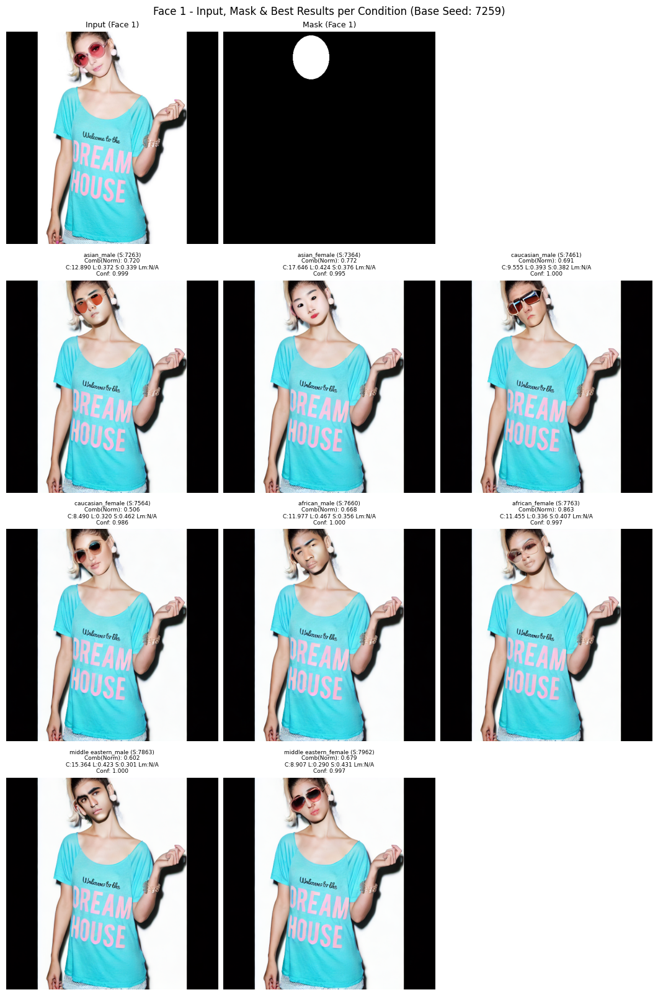

In [28]:
# --- Example Call Block ---
# This block demonstrates how to call the test function.
# It includes setting up dummy components if real ones are not available.
# It should be placed under `if __name__ == "__main__":` for standard practice.
if __name__ == "__main__":
    logging.info("--- Running Example Call Block ---")

    # --- Dummy Data / Placeholders (Replace with actual implementations) ---
    # Assume CONFIG is defined globally or loaded here. If not, create a minimal one.
    if 'CONFIG' not in locals():
        CONFIG = {
            "device": "cuda" if torch.cuda.is_available() else "cpu",
            "image_size": 512,
            # Add other necessary config defaults if test_run_module_4_5_reranked
            # doesn't set them internally via setdefault.
        }
        logging.info("Using minimal dummy CONFIG for example call.")

    # List of image paths. Create a dummy image if the list is empty or doesn't exist.
    if 'image_files' not in locals() or not image_files:
        dummy_dir = "./dummy_images_for_test/"
        os.makedirs(dummy_dir, exist_ok=True)
        dummy_image_path = os.path.join(dummy_dir, "dummy_input_red.png")
        try:
            # Create a simple red image
            Image.new('RGB', (600, 800), color = 'red').save(dummy_image_path)
            image_files = [dummy_image_path]
            logging.info(f"Created dummy image for testing at: {dummy_image_path}")
        except Exception as e:
            logging.error(f"Failed to create dummy image: {e}")
            image_files = [] # Ensure list is empty if creation fails

    # Face Detector (e.g., MTCNN). Use a dummy if not available.
    if 'mtcnn_detector' not in locals() or mtcnn_detector is None:
        logging.warning("Using dummy MTCNN detector for example call.")
        class DummyMTCNNDetector:
            def detect(self, img_np, landmarks=False):
                # Simulate detecting one face roughly in the center
                h, w = img_np.shape[:2]
                # Define box coords [x1, y1, x2, y2]
                box = [w * 0.25, h * 0.25, w * 0.75, h * 0.75]
                prob = [0.99] # Simulate high confidence
                # Return format: list of boxes (as numpy arrays), list of probabilities
                return [np.array(box)], np.array(prob)
        mtcnn_detector = DummyMTCNNDetector()

    # Age Estimator. Use a dummy if not available.
    if 'estimate_age' not in locals() or estimate_age is None:
        logging.warning("Using dummy age estimator (always returns 'adult').")
        # Simple lambda function returning a default value
        estimate_age = lambda face_crop_pil: "adult"

    # Yaw Estimator. Use a dummy if not available.
    # CRITICAL: Dummy must match the expected return type: List[Tuple[float, str]]
    if 'estimate_yaw_mediapipe' not in locals() or estimate_yaw_mediapipe is None:
        logging.warning("Using dummy yaw estimator (returns [(0.0, '')] for each box).")
        def dummy_yaw_estimator(img_pil, boxes_list):
            # Return one default tuple (0.0 degrees, empty suffix) per input box
            return [(0.0, "")] * len(boxes_list)
        estimate_yaw_mediapipe = dummy_yaw_estimator

    # Image Resizing Helper. Use a dummy if not available.
    if 'resize_with_padding' not in locals() or resize_with_padding is None:
        logging.warning("Using dummy resize_with_padding (simple resize, no padding).")
        # Simple resize, might distort aspect ratio if not square input/output
        resize_with_padding = lambda img, target_size: img.resize(target_size, Image.Resampling.LANCZOS)

    # Face Filtering Helper. Use a dummy if not available.
    if 'detect_faces_with_filter' not in locals() or detect_faces_with_filter is None:
        logging.warning("Using dummy detect_faces_with_filter.")
        def dummy_detect_filter(img_pil, detector, min_area_ratio, min_confidence, verbose):
             # Use the provided (potentially dummy) detector
             img_np = np.array(img_pil)
             boxes, probs = detector.detect(img_np) # Call the detector
             # Basic filtering simulation based on confidence
             kept_faces_list = []
             if boxes is not None and probs is not None and len(boxes) > 0:
                  if probs[0] >= min_confidence:
                      # Return format requires list of tuples: [(box, prob)]
                      kept_faces_list.append((boxes[0], probs[0]))
             # Return format: kept_faces, all_boxes (optional), all_probs (optional)
             all_boxes = boxes if boxes is not None else []
             all_probs = probs if probs is not None else []
             return kept_faces_list, all_boxes, all_probs
        detect_faces_with_filter = dummy_detect_filter

    # Inpainting Pipeline (Stable Diffusion, etc.). Use a dummy if not available.
    if 'pipe_lora' not in locals() or pipe_lora is None:
        logging.warning("Using dummy inpainting pipeline (returns gradient image).")
        class DummyPipeline:
            def __call__(self, prompt, negative_prompt, image, mask_image, guidance_scale, num_inference_steps, generator):
                # Simulate a simple output image (e.g., a gradient)
                S = image.size[0] # Get size from input image
                # Create a grayscale gradient
                gradient_array = np.tile(np.linspace(0, 255, S), (S, 1)).astype(np.uint8)
                gradient_pil = Image.fromarray(gradient_array).convert("L")
                # Colorize the gradient for visual effect
                gradient_color = ImageOps.colorize(gradient_pil, black="blue", white="yellow")
                # Apply the mask: show gradient where mask is white, original image otherwise
                # Ensure mask is L mode for composite
                masked_output = Image.composite(gradient_color, image, mask_image.convert("L"))
                # Return object mimicking pipeline output structure
                class Result: images = [masked_output]
                return Result()
        pipe_lora = DummyPipeline()

    # --- Check Essential Components Again Before Calling ---
    # face_mesh should be initialized globally near the top.
    # CLIP/LPIPS models might be None, handled inside test function.
    essential_for_test_call = [
        image_files, mtcnn_detector, estimate_age, estimate_yaw_mediapipe,
        pipe_lora, resize_with_padding, detect_faces_with_filter, face_mesh
    ]
    if all(comp is not None for comp in essential_for_test_call):
        logging.info("All essential components (including dummies) seem available. Attempting test run...")
        # Make the actual call to the test function
        test_results = test_run_module_4_5_reranked(
            image_files=image_files,
            mtcnn_detector=mtcnn_detector,
            estimate_age=estimate_age,
            estimate_yaw_mediapipe=estimate_yaw_mediapipe,
            config=CONFIG, # Pass the configuration dictionary
            pipe_lora=pipe_lora,
            run_module_4_5_reranked_func=run_module_4_5_reranked, # Pass the main function to be tested
            clip_model=clip_model,          # Pass potentially None CLIP model
            clip_processor=clip_processor,  # Pass potentially None CLIP processor
            resize_with_padding=resize_with_padding,
            detect_faces_with_filter=detect_faces_with_filter,
            lpips_model=lpips_model,        # Pass potentially None LPIPS model
            save_images=True,               # Enable saving output images
            plot_results=True,              # Enable plotting results
            output_dir="./inpainted_faces_landmark_norm_test/", # Specify output dir
        )
        logging.info("--- Main Test Run Execution Attempt Finished ---")
        if test_results is not None:
            logging.info(f"Test function completed and returned results for {len(test_results)} faces.")
        else:
            logging.warning("Test function completed but did not return results (returned None). Check logs for errors.")
    else:
        # Log which essential components were missing if the test cannot run
        missing_components = [name for name, comp in zip([
            "image_files", "mtcnn_detector", "estimate_age", "estimate_yaw_mediapipe",
            "pipe_lora", "resize_with_padding", "detect_faces_with_filter", "face_mesh"
        ], essential_for_test_call) if comp is None]
        logging.error(
            f"--- Main Test Run Skipped: Essential components missing: {missing_components}. ---"
        )

In [49]:
# =============================================================================
# MODULE 5: Batch Inpaint, Zip, and Upload
# =============================================================================

import os
import glob
import shutil
import logging
import traceback
import zipfile # Make sure zipfile is imported
from tqdm.notebook import tqdm # Use notebook version for better Colab display
from PIL import Image, ImageDraw # Added ImageDraw

# Ensure necessary functions from previous modules are available:
# resize_with_padding, detect_faces_with_filter,
# estimate_age, estimate_pose_mediapipe,
# run_module_4_5_reranked

# Ensure necessary models/objects are available:
# pipe_lora, mtcnn_detector, clip_model, clip_processor, lpips_model

def inpaint_and_upload_faces(
    config: dict,
    pipe_lora,
    mtcnn_detector,
    estimate_age_func,
    estimate_pose_func, # Use the pose estimator which returns yaw/pitch
    resize_func,
    detect_filter_func,
    # Mask generation is now handled inside the loop
    rerank_func,
    clip_model,
    clip_processor,
    lpips_model,
):
    """
    Downloads a zip file from GDrive, unzips it locally, inpaints faces
    from the extracted images, saves results locally, zips the results,
    and uploads the results zip back to GDrive.
    """
    logging.info("--- Starting Module 5: Batch Inpainting ---")

    gdrive_zip_source = config['laion_zip_drive_path']
    local_source = config['local_laion_folder'] # Target directory for unzipped images
    local_output = config['local_output_folder']
    local_temp_zip = "/content/temp_source_images.zip" # Temporary path for downloaded zip
    local_results_zip_file = "/content/inpainted_results.zip" # Temp local path for results zip
    gdrive_dest_zip = config['gdrive_output_zip_path']
    img_size = config['image_size']

    # --- 1. Download Zip from Google Drive and Unzip Locally ---
    logging.info(f"Copying zip file from GDrive '{gdrive_zip_source}' to local '{local_temp_zip}'...")
    try:
        # --- a. Copy the zip file ---
        if os.path.exists(local_temp_zip):
            os.remove(local_temp_zip) # Remove previous temp zip if exists

        copy_command = f"cp \"{gdrive_zip_source}\" \"{local_temp_zip}\""
        print(f"Running copy command: {copy_command}")
        copy_result = os.system(copy_command)

        if copy_result != 0 or not os.path.exists(local_temp_zip):
             raise OSError(f"Copy command failed (exit code {copy_result}) or zip file not found locally at {local_temp_zip}")
        logging.info(f"✅ Successfully copied zip file to {local_temp_zip}.")

        # --- b. Prepare local extraction folder ---
        if os.path.exists(local_source):
            shutil.rmtree(local_source) # Clear previous extraction if exists
        os.makedirs(local_source)
        logging.info(f"Created local extraction directory: {local_source}")

        # --- c. Unzip the file ---
        logging.info(f"Unzipping '{local_temp_zip}' into '{local_source}'...")
        # Use shell unzip command for potentially better performance/handling
        unzip_command = f"unzip -q \"{local_temp_zip}\" -d \"{local_source}\"" # -q for quiet
        print(f"Running unzip command: {unzip_command}")
        unzip_result = os.system(unzip_command)

        if unzip_result != 0:
             # Try with Python's zipfile as a fallback or for more info
             try:
                 with zipfile.ZipFile(local_temp_zip, 'r') as zip_ref:
                     zip_ref.extractall(local_source)
                 logging.info("Unzipped successfully using Python zipfile fallback.")
             except Exception as zip_err:
                 raise OSError(f"Shell unzip failed (code {unzip_result}) and Python zipfile failed: {zip_err}") from zip_err

        # --- d. Verify extraction ---
        extracted_files = glob.glob(os.path.join(local_source, '**', '*.*'), recursive=True) # Check subdirs too
        # Filter out potential hidden files or directories like __MACOSX
        valid_extracted_files = [f for f in extracted_files if not os.path.basename(f).startswith('.') and os.path.isfile(f) and '__MACOSX' not in f]

        if not valid_extracted_files:
            logging.error(f"❌ Failed to unzip or no valid image files found in extracted folder: {local_source}")
            print(f"Debug: Contents of local source '{local_source}' after unzip attempt:")
            os.system(f"ls -lhaR '{local_source}'") # Show directory contents recursively
            # Clean up temp zip if extraction failed
            if os.path.exists(local_temp_zip): os.remove(local_temp_zip)
            return False
        logging.info(f"✅ Successfully unzipped and found {len(valid_extracted_files)} files in {local_source}.")

        # --- e. Clean up temporary zip file ---
        if os.path.exists(local_temp_zip):
            os.remove(local_temp_zip)
            logging.info(f"Removed temporary zip file: {local_temp_zip}")

    except Exception as e:
        logging.error(f"❌ Error during GDrive zip download/unzip: {e}")
        traceback.print_exc()
        # Clean up potentially partially extracted files or temp zip
        if os.path.exists(local_source): shutil.rmtree(local_source)
        if os.path.exists(local_temp_zip): os.remove(local_temp_zip)
        return False

    # --- 2. Prepare Local Output Directory ---
    logging.info(f"Preparing local output directory: {local_output}")
    try:
        if os.path.exists(local_output):
            shutil.rmtree(local_output) # Clear previous results
        os.makedirs(local_output)
        logging.info("✅ Local output directory cleared and created.")
    except Exception as e:
        logging.error(f"❌ Error preparing local output directory: {e}")
        return False

    # --- 3. Iterate and Inpaint Images ---
    logging.info("Starting batch inpainting process...")
    # Search for images potentially in subdirectories after unzipping
    image_paths = glob.glob(os.path.join(local_source, '**', '*.jpg'), recursive=True) + \
                  glob.glob(os.path.join(local_source, '**', '*.png'), recursive=True) + \
                  glob.glob(os.path.join(local_source, '**', '*.jpeg'), recursive=True)

    # Filter out potential junk like macOS resource fork files
    image_paths = [p for p in image_paths if not os.path.basename(p).startswith('._') and '__MACOSX' not in p]


    if not image_paths:
        logging.warning("⚠️ No valid images found in the unzipped source directory to process.")
        # Proceed to zipping (will create an empty zip) and uploading
    else:
        logging.info(f"Found {len(image_paths)} images to process.")

    processed_count = 0
    skipped_count = 0
    error_count = 0

    # Use tqdm for progress bar
    for img_path in tqdm(image_paths, desc="Inpainting Images"):
        img_filename = os.path.basename(img_path)
        # Create a unique base name, potentially including subdirectory structure
        relative_path = os.path.relpath(img_path, local_source)
        img_basename = os.path.splitext(relative_path.replace(os.sep, '_'))[0] # Replace slashes for safe filename
        logging.debug(f"\nProcessing image: {img_filename} (Rel: {relative_path})")

        try:
            # --- a. Load and Prepare Image ---
            # Add check for invalid image files before opening
            if not os.path.isfile(img_path) or os.path.getsize(img_path) == 0:
                logging.warning(f"  - Skipped: Invalid or zero-size file: {img_filename}")
                skipped_count += 1
                continue
            raw_img = Image.open(img_path).convert("RGB")
            img_padded = resize_func(raw_img, target_size=(img_size, img_size))

            # --- b. Detect Faces ---
            kept_faces, _, _ = detect_filter_func(
                img_padded,
                mtcnn_detector,
                min_area_ratio=config["min_face_ratio"],
                min_confidence=config["min_confidence"],
                verbose=False # Keep logs cleaner during batch processing
            )

            if not kept_faces:
                logging.debug(f"  - Skipped: No valid faces detected in {img_filename}.")
                skipped_count += 1
                continue

            boxes = [box for box, prob in kept_faces]
            # probs = [prob for box, prob in kept_faces] # Probs not strictly needed below
            logging.debug(f"  - Detected {len(boxes)} faces.")

            # --- c. Generate Masks (Elliptical) ---
            face_masks = []
            valid_boxes_for_masks = [] # Store boxes corresponding to generated masks
            for i_mask, (box, prob) in enumerate(kept_faces):
                 # Create a mask for *this specific face*
                 temp_mask = Image.new("L", img_padded.size, 0)
                 draw = ImageDraw.Draw(temp_mask)
                 # Expand ratio can be adjusted via config if needed
                 expand_ratio = config.get("mask_expand_ratio", 1.3) # Default expand ratio
                 x1, y1, x2, y2 = map(int, box)
                 cx, cy = (x1 + x2) / 2, (y1 + y2) / 2
                 w = (x2 - x1) * expand_ratio
                 h = (y2 - y1) * expand_ratio
                 x1n = max(0, int(cx - w/2))
                 y1n = max(0, int(cy - h/2))
                 x2n = min(img_size, int(cx + w/2))
                 y2n = min(img_size, int(cy + h/2))

                 # Only add mask if the expanded box is valid
                 if x1n < x2n and y1n < y2n:
                     draw.ellipse([x1n, y1n, x2n, y2n], fill=255)
                     face_masks.append(temp_mask)
                     valid_boxes_for_masks.append(box) # Keep the original box associated with this mask
                 else:
                     logging.warning(f"  - Skipped mask for face {i_mask} in {img_filename} due to invalid expanded coords.")

            if not face_masks:
                 logging.warning(f"  - Skipped {img_filename}: No valid masks generated after expansion.")
                 skipped_count += 1
                 continue

            # Ensure boxes list matches the generated masks
            if len(valid_boxes_for_masks) != len(face_masks):
                 logging.error(f"Critical mismatch between valid boxes ({len(valid_boxes_for_masks)}) and masks ({len(face_masks)}) for {img_filename}. Skipping.")
                 error_count += 1
                 continue
            boxes_to_use = valid_boxes_for_masks # Use the boxes corresponding to the masks

            logging.debug(f"  - Generated {len(face_masks)} masks.")

            # --- d. Estimate Age & Pose ---
            age_labels = []
            for i_age, box in enumerate(boxes_to_use):
                age = "adult" # Default
                try:
                    coords = tuple(map(int, box))
                    if coords[0] < coords[2] and coords[1] < coords[3]:
                         face_crop = img_padded.crop(coords)
                         if face_crop:
                             est_age = estimate_age_func(face_crop)
                             age = str(est_age if est_age is not None else "adult")
                except Exception as e_age:
                     logging.warning(f"  - Age estimation error face {i_age} in {img_filename}: {e_age}")
                age_labels.append(age)

            # Use the pose estimator (which should handle potential errors internally)
            pose_data_list = estimate_pose_func(img_padded, boxes_to_use, config)

            # Extract just yaw and yaw_suffix for the rerank function's expected input
            yaw_data_for_rerank = []
            valid_poses = True
            yaw_skip = config.get("skip_yaw_threshold", 100)
            pitch_skip = config.get("skip_pitch_threshold", 100)

            if len(pose_data_list) != len(boxes_to_use):
                 logging.warning(f"  - Pose data length mismatch ({len(pose_data_list)}) vs boxes ({len(boxes_to_use)}) for {img_filename}. Using defaults.")
                 yaw_data_for_rerank = [(0.0, "")] * len(boxes_to_use) # Fallback
            else:
                 for i_pose, pose_tuple in enumerate(pose_data_list):
                      try:
                           yaw, pitch, yaw_suffix, _ = pose_tuple
                           # Check for extreme poses that warrant skipping the whole image
                           if abs(yaw) > yaw_skip or abs(pitch) > pitch_skip:
                                logging.warning(f"  - Skipping {img_filename}: Face {i_pose} has extreme pose (Yaw: {yaw:.1f}, Pitch: {pitch:.1f}).")
                                valid_poses = False
                                break # Stop checking poses for this image
                           yaw_data_for_rerank.append((yaw, yaw_suffix))
                      except (TypeError, ValueError, IndexError) as e_pose_unpack:
                           logging.warning(f"  - Error unpacking pose data for face {i_pose} in {img_filename}: {e_pose_unpack}. Using default.")
                           yaw_data_for_rerank.append((0.0, "")) # Fallback for this face

            if not valid_poses:
                 skipped_count += 1
                 continue # Skip to the next image file

            logging.debug(f"  - Estimated age/pose for {len(boxes_to_use)} faces.")

            # --- e. Run Reranking/Inpainting Function ---
            base_prompt = "realistic photograph human face"
            base_extra_tags = "highly detailed, intricate details, sharp focus, ultra-detailed skin texture, masterpiece, best quality, cinematic lighting, photorealistic"
            base_neg_prompt = "deformed, cartoon, illustration, painting, drawing, sketch, anime, manga, disfigured, ugly, blurry, low quality, noisy, text, signature, watermark, multiple faces, extra limbs, fused fingers, bad anatomy, worst quality, lowres, jpeg artifacts, normal quality"

            inpainting_results = rerank_func(
                image_pil=img_padded,
                face_masks=face_masks,
                boxes=boxes_to_use,
                age_labels=age_labels,
                yaw_data=yaw_data_for_rerank,
                pipe_lora=pipe_lora,
                mtcnn_detector=mtcnn_detector,
                lpips_model=lpips_model,
                clip_model=clip_model,
                clip_processor=clip_processor,
                config=config,
                base_prompt=base_prompt,
                base_extra_tags=base_extra_tags,
                base_neg_prompt=base_neg_prompt,
                plot=False
            )

            # --- f. Save Successful Results ---
            if inpainting_results:
                saved_count_for_img = 0
                for face_idx, face_results_dict in inpainting_results.items():
                    if isinstance(face_results_dict, dict):
                        for cond_key, best_data in face_results_dict.items():
                            if best_data and isinstance(best_data, dict) and best_data.get("img"):
                                img_to_save = best_data["img"]
                                seed = best_data.get("seed", "unknown")
                                # Use the modified img_basename which includes relative path info
                                save_fname = f"{img_basename}_face{face_idx}_{cond_key}_seed{seed}.png"
                                save_path = os.path.join(local_output, save_fname)
                                try:
                                    img_to_save.save(save_path)
                                    saved_count_for_img += 1
                                except Exception as e_save:
                                    logging.error(f"  - Error saving result '{save_fname}': {e_save}")
                if saved_count_for_img > 0:
                     logging.debug(f"  - Saved {saved_count_for_img} inpainted results for {img_filename}.")
                     processed_count += 1
                else:
                     logging.debug(f"  - No results saved for {img_filename} (inpainting might have failed for all conditions).")
                     processed_count += 1 # Count as processed even if no output saved
            else:
                logging.warning(f"  - Rerank function returned no results for {img_filename}.")
                skipped_count += 1 # Count as skipped if the main function returned nothing

        except (IOError, SyntaxError) as e_open:
             logging.error(f"❌ Error opening or reading image {img_filename}: {e_open}. Skipping.")
             error_count += 1
        except Exception as e_img:
            logging.error(f"❌ Unhandled error processing image {img_filename}: {e_img}")
            traceback.print_exc()
            error_count += 1

    logging.info(f"--- Batch Inpainting Summary ---")
    logging.info(f"  Total Images Found: {len(image_paths)}")
    logging.info(f"  Successfully Processed (attempted): {processed_count}")
    logging.info(f"  Skipped (no faces/masks/bad pose/invalid file): {skipped_count}")
    logging.info(f"  Errors during processing: {error_count}")
    logging.info(f"  Inpainted images saved to: {local_output}")

    # --- 4. Zip the Output Folder ---
    logging.info(f"Zipping the output folder '{local_output}' to '{local_results_zip_file}'...")
    try:
        if os.path.exists(local_results_zip_file):
            os.remove(local_results_zip_file)

        if not os.path.exists(local_output) or not os.listdir(local_output):
             logging.warning(f"Output directory '{local_output}' is empty or does not exist. Creating an empty zip file.")
             with zipfile.ZipFile(local_results_zip_file, 'w') as zf:
                 pass
        else:
             # Use shell zip command
             zip_command = f"zip -r -j \"{local_results_zip_file}\" \"{local_output}/\"" # -j junks paths
             print(f"Running zip command: {zip_command}")
             zip_result = os.system(zip_command)
             if zip_result != 0:
                 raise OSError(f"Zip command failed with exit code {zip_result}")

        if not os.path.exists(local_results_zip_file):
             raise FileNotFoundError("Zip file was not created successfully.")

        logging.info(f"✅ Successfully created results zip file: {local_results_zip_file}")

    except Exception as e:
        logging.error(f"❌ Error during zipping results: {e}")
        traceback.print_exc()
        return False

    # --- 5. Upload Results Zip to Google Drive ---
    logging.info(f"Uploading '{local_results_zip_file}' to GDrive '{gdrive_dest_zip}'...")
    try:
        gdrive_dest_dir = os.path.dirname(gdrive_dest_zip)
        os.makedirs(gdrive_dest_dir, exist_ok=True)

        upload_command = f"cp \"{local_results_zip_file}\" \"{gdrive_dest_zip}\""
        print(f"Running upload command: {upload_command}")
        upload_result = os.system(upload_command)

        if upload_result != 0:
            print("Upload command failed. Checking Drive status...")
            os.system("df -h /content/drive/MyDrive")
            raise OSError(f"Upload command failed with exit code {upload_result}")

        logging.info(f"✅ Successfully uploaded results zip file to {gdrive_dest_zip}.")

    except Exception as e:
        logging.error(f"❌ Error during GDrive upload: {e}")
        traceback.print_exc()
        logging.warning(f"Local results zip file kept at: {local_results_zip_file}")
        return False

    # --- 6. Cleanup (Optional) ---
    cleanup = config.get("cleanup_local_files", True)
    if cleanup:
        logging.info("Cleaning up local temporary files and folders...")
        try:
            if os.path.exists(local_source):
                shutil.rmtree(local_source)
            if os.path.exists(local_output):
                shutil.rmtree(local_output)
            if os.path.exists(local_results_zip_file):
                os.remove(local_results_zip_file)
            # Keep local_temp_zip cleanup within the try block of Step 1
            logging.info("✅ Local cleanup complete.")
        except Exception as e:
            logging.warning(f"⚠️ Error during local cleanup: {e}")

    logging.info("--- Module 5: Batch Inpainting Finished Successfully ---")
    return True

# =============================================================================
# Example Call for Module 5 (Place this after Module 3 and function definitions)
# =============================================================================

# Ensure all necessary components from previous modules are loaded and ready:
# CONFIG, pipe_lora, mtcnn_detector, estimate_age, estimate_pose_mediapipe,
# resize_with_padding, detect_faces_with_filter, run_module_4_5_reranked,
# clip_model, clip_processor, lpips_model

# Check if essential components exist before calling
if all(k in globals() for k in ['CONFIG', 'pipe_lora', 'mtcnn_detector', 'estimate_age', 'estimate_pose_mediapipe', 'resize_with_padding', 'detect_faces_with_filter', 'run_module_4_5_reranked']):
    # Make sure the necessary zipfile module is imported for the example call check too
    import zipfile
    print("\n🚀🚀🚀 Starting Batch Inpainting Workflow 🚀🚀🚀")
    success = inpaint_and_upload_faces(
        config=CONFIG,
        pipe_lora=pipe_lora,
        mtcnn_detector=mtcnn_detector,
        estimate_age_func=estimate_age,
        estimate_pose_func=estimate_pose_mediapipe,
        resize_func=resize_with_padding,
        detect_filter_func=detect_faces_with_filter,
        rerank_func=run_module_4_5_reranked,
        clip_model=clip_model if 'clip_model' in globals() else None,
        clip_processor=clip_processor if 'clip_processor' in globals() else None,
        lpips_model=lpips_model if 'lpips_model' in globals() else None,
    )

    if success:
        print("\n✅✅✅ Batch Inpainting Workflow Completed Successfully! ✅✅✅")
        print(f"Check your Google Drive for the results zip: {CONFIG['gdrive_output_zip_path']}")
    else:
        print("\n❌❌❌ Batch Inpainting Workflow Failed. Check logs above for errors. ❌❌❌")
        print(f"The local results zip file might still be available at: {local_results_zip_file} (if zipping succeeded)")

else:
    print("\n⚠️⚠️⚠️ Skipping Batch Inpainting Workflow: Not all required components (CONFIG, pipelines, models, functions) are defined. Please ensure Modules 1-4.5 ran successfully.")


🚀🚀🚀 Starting Batch Inpainting Workflow 🚀🚀🚀
Running copy command: cp "/content/drive/MyDrive/fairface_folder/fairface_data/FairFace/laion_face_images.zip" "/content/temp_source_images.zip"
Running unzip command: unzip -q "/content/temp_source_images.zip" -d "/content/laion_face_images_input"


Inpainting Images:   0%|          | 0/897 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

KeyboardInterrupt: 